In [2]:
import os
os.chdir('mmpose')

In [2]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-m-Dog_hip_all/best_PCK_epoch_5.pth \
        checkpoint/all_m_best_PCK_epoch_5.pth

08/03 02:12:48 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
08/03 02:12:48 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [3]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-l-Dog_hip_all/epoch_200.pth \
        checkpoint/all_best_PCK_epoch_200.pth

07/21 04:36:17 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/21 04:36:17 - mmengine - INFO - Key `optimizer` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/21 04:36:17 - mmengine - INFO - Key `param_schedulers` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/21 04:36:17 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [1]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import pandas as pd

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



In [3]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [4]:
# rtmdet
detector = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_m_dog_hip_all.py',
    
    '/home/featurize/work/mmdetection/checkpoint/best_m_all_epoch_287-487eb8f1.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/best_m_all_epoch_287-487eb8f1.pth


In [5]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

detect_result = inference_detector(detector, img_path)

/environment/miniconda3/lib/python3.7/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [6]:
detect_result.keys()

['pred_instances', 'gt_instances', 'ignored_instances']

In [7]:
labels =detect_result.pred_instances.labels
labels

tensor([1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0,
        1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0,
        0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1,
        0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0,
        1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1,
        0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1,
        0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0,

In [8]:
print(dir(detect_result.pred_instances))

['__class__', '__contains__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__len__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setitem__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_data_fields', '_metainfo_fields', 'all_items', 'all_keys', 'all_values', 'bboxes', 'cat', 'clone', 'cpu', 'cuda', 'detach', 'get', 'items', 'keys', 'labels', 'metainfo', 'metainfo_items', 'metainfo_keys', 'metainfo_values', 'mlu', 'musa', 'new', 'npu', 'numpy', 'pop', 'scores', 'set_data', 'set_field', 'set_metainfo', 'to', 'to_dict', 'to_tensor', 'update', 'values']


In [9]:
scores = detect_result.pred_instances.scores
scores 

tensor([0.8907, 0.8867, 0.8737, 0.8702, 0.0294, 0.0287, 0.0280, 0.0233, 0.0230,
        0.0224, 0.0221, 0.0208, 0.0204, 0.0200, 0.0195, 0.0193, 0.0193, 0.0192,
        0.0189, 0.0182, 0.0181, 0.0180, 0.0177, 0.0176, 0.0172, 0.0169, 0.0168,
        0.0167, 0.0164, 0.0164, 0.0163, 0.0162, 0.0161, 0.0160, 0.0160, 0.0160,
        0.0154, 0.0154, 0.0153, 0.0153, 0.0148, 0.0148, 0.0146, 0.0145, 0.0144,
        0.0143, 0.0142, 0.0142, 0.0140, 0.0139, 0.0139, 0.0136, 0.0133, 0.0132,
        0.0130, 0.0130, 0.0130, 0.0129, 0.0127, 0.0126, 0.0125, 0.0122, 0.0121,
        0.0121, 0.0120, 0.0120, 0.0119, 0.0118, 0.0118, 0.0118, 0.0118, 0.0118,
        0.0118, 0.0118, 0.0116, 0.0115, 0.0114, 0.0114, 0.0114, 0.0114, 0.0113,
        0.0113, 0.0112, 0.0112, 0.0112, 0.0111, 0.0111, 0.0111, 0.0111, 0.0110,
        0.0109, 0.0109, 0.0109, 0.0109, 0.0109, 0.0109, 0.0108, 0.0108, 0.0108,
        0.0108, 0.0107, 0.0105, 0.0105, 0.0105, 0.0104, 0.0104, 0.0103, 0.0101,
        0.0101, 0.0100, 0.0100, 0.0099, 

In [10]:
bboxes=detect_result.pred_instances.bboxes[:]
bboxes

tensor([[670.9723, 102.6737, 777.4457, 208.7479],
        [203.4628, 117.4417, 313.1943, 226.7877],
        [690.3491,  43.8762, 797.8333, 150.8404],
        ...,
        [103.2378,   0.0000, 228.7820,  18.5969],
        [ 82.3360, 181.3803, 108.6817, 215.5638],
        [670.5011, 157.0962, 734.7714, 208.8127]], device='cuda:0')

In [11]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-m-Dog_hip_all.py',
    '/home/featurize/work/mmpose/checkpoint/all_m_best_PCK_epoch_5-eac12d89_20240725.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/all_m_best_PCK_epoch_5-eac12d89_20240725.pth


Processing /home/featurize/work/Dataset2/data/Testing/Images/340563.jpeg
08/09 05:50:10 - mmengine - WARNING - The current default scope "mmpose" is not "mmdet", `init_default_scope` will force set the currentdefault scope to "mmdet".
08/09 05:50:10 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".
head: [[[516 139]]

 [[240 108]]]
center: [[[525 166]]

 [[221 129]]]


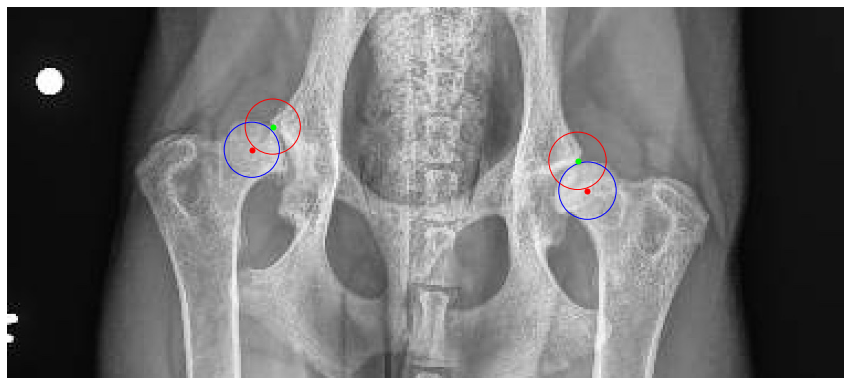

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg
head: [[[456 111]]

 [[179 101]]]
center: [[[481 105]]

 [[163  91]]]


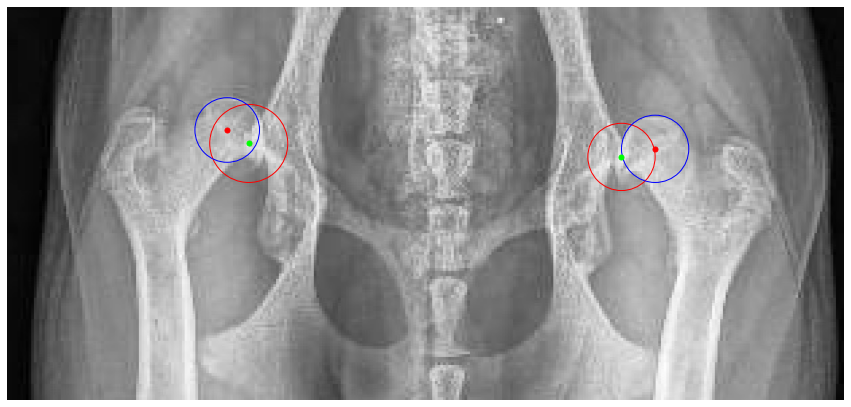

Processing /home/featurize/work/Dataset2/data/Testing/Images/328949.jpeg
head: [[[341 138]]

 [[684 154]]]
center: [[[695 192]]

 [[317 170]]]


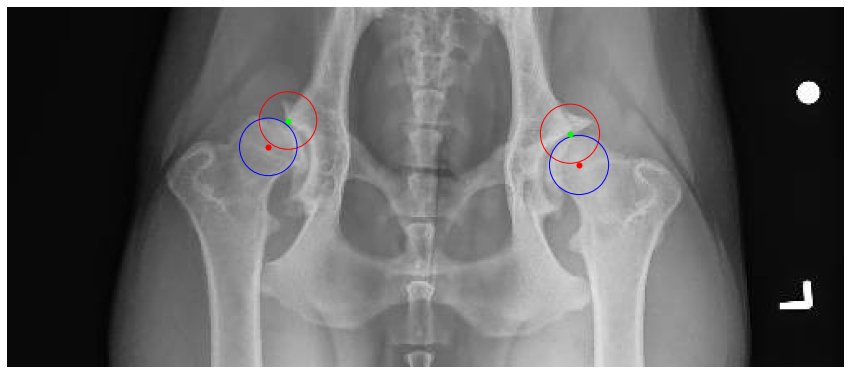

Processing /home/featurize/work/Dataset2/data/Testing/Images/348742.jpeg
head: [[[448 123]]

 [[197 113]]]
center: [[[437 152]]

 [[203 143]]]


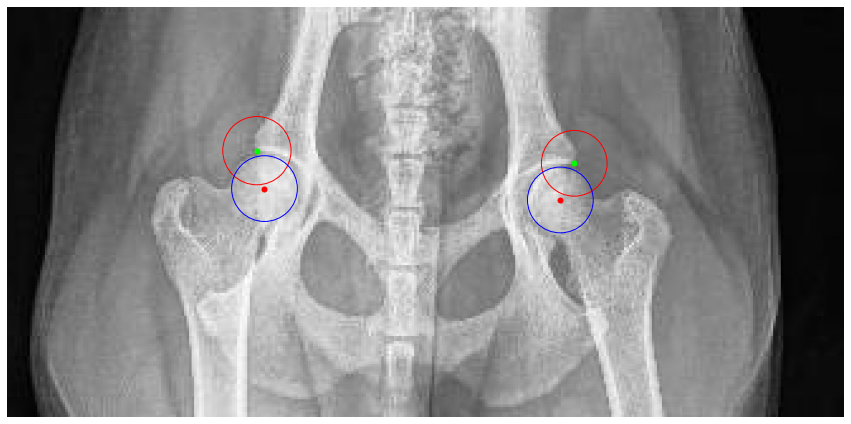

Processing /home/featurize/work/Dataset2/data/Testing/Images/355767.jpeg
head: [[[286 110]]

 [[617 119]]]
center: [[[603 158]]

 [[295 149]]]


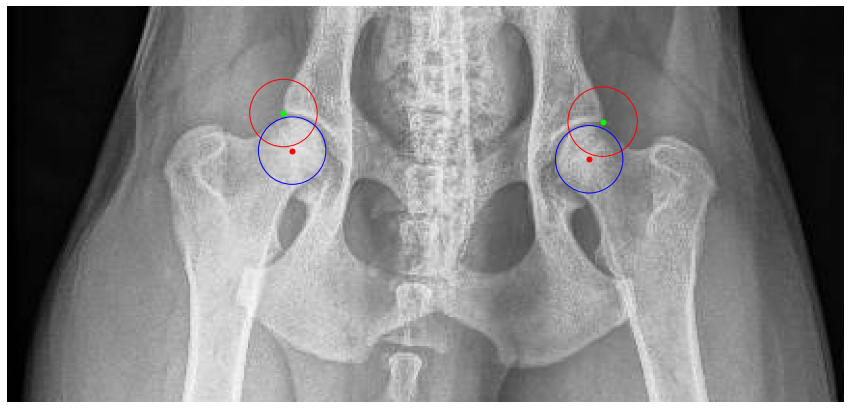

Processing /home/featurize/work/Dataset2/data/Testing/Images/353517.jpeg
head: [[[453  86]]

 [[182  96]]]
center: [[[192 126]]

 [[452 118]]]


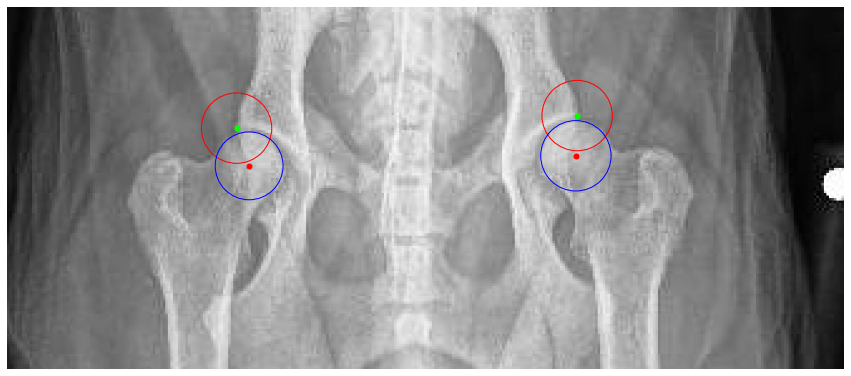

Processing /home/featurize/work/Dataset2/data/Testing/Images/355524.jpeg
head: [[[477 115]]

 [[182 114]]]
center: [[[484 151]]

 [[172 149]]]


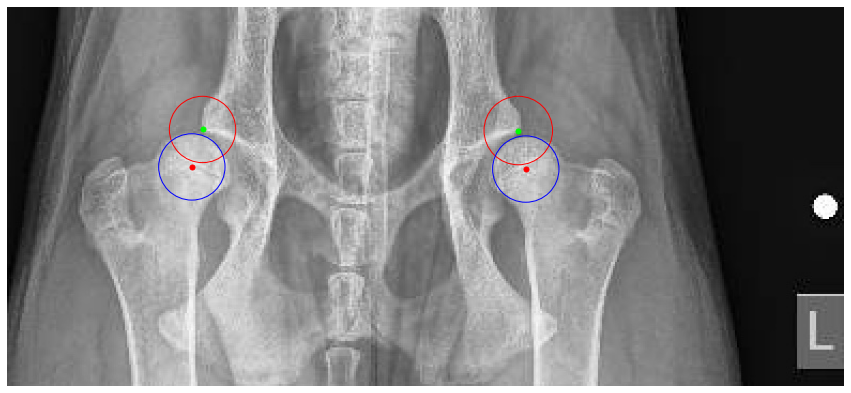

Processing /home/featurize/work/Dataset2/data/Testing/Images/358587.jpeg
head: [[[405  62]]

 [[171  70]]]
center: [[[398  88]]

 [[178  96]]]


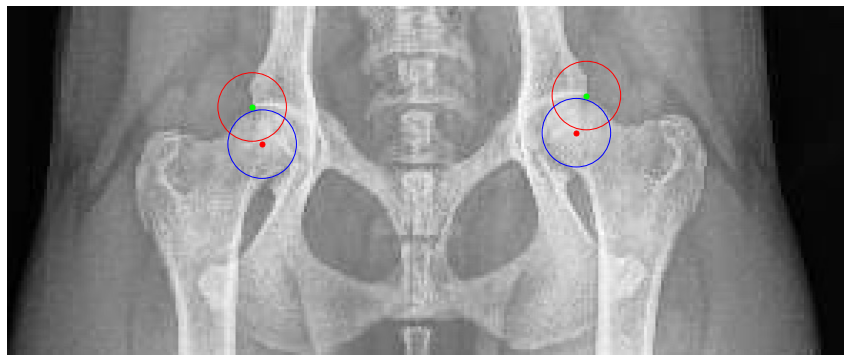

Processing /home/featurize/work/Dataset2/data/Testing/Images/355223.jpeg
head: [[[622 122]]

 [[364 119]]]
center: [[[615 146]]

 [[371 144]]]


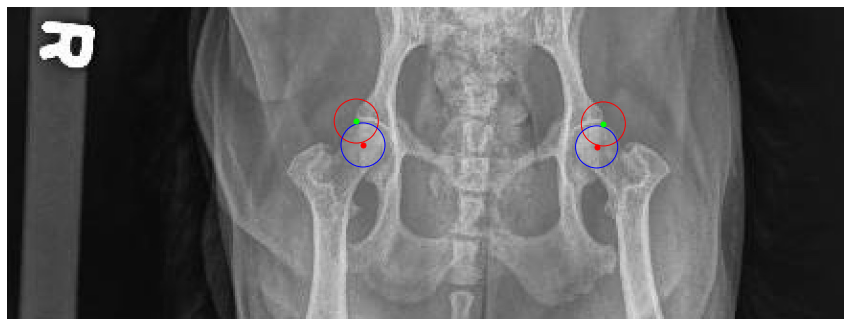

Processing /home/featurize/work/Dataset2/data/Testing/Images/264113.jpeg
head: [[[595 102]]

 [[302  78]]]
center: [[[581 136]]

 [[303 112]]]


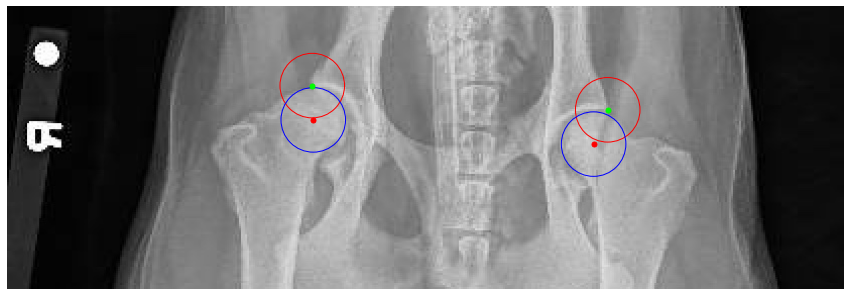

Processing /home/featurize/work/Dataset2/data/Testing/Images/365780.jpeg
head: [[[591 137]]

 [[209 118]]]
center: [[[569 183]]

 [[225 164]]]


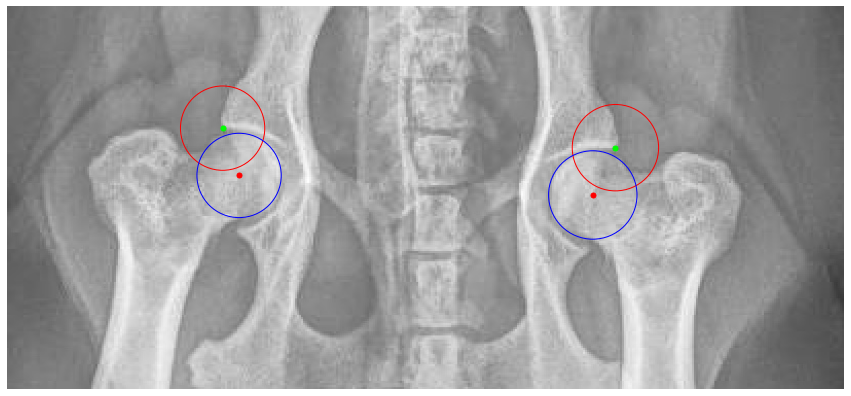

Processing /home/featurize/work/Dataset2/data/Testing/Images/360388.jpeg
head: [[[447  81]]

 [[145  59]]]
center: [[[433 113]]

 [[153  94]]]


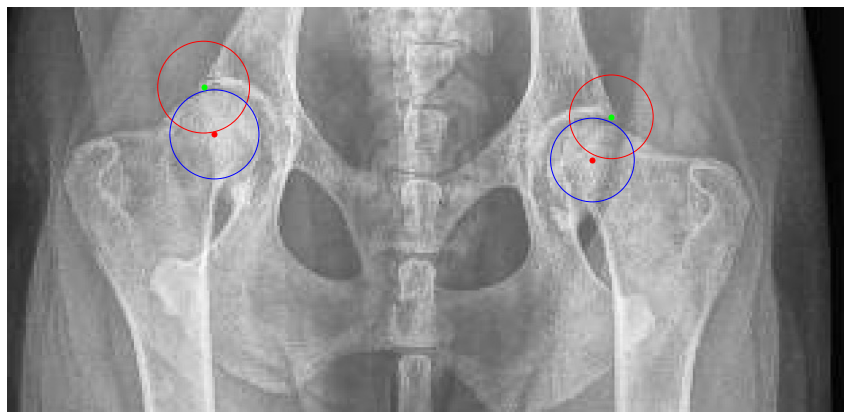

Processing /home/featurize/work/Dataset2/data/Testing/Images/246775.jpeg
head: [[[284  33]]

 [[120  32]]]
center: [[[278  51]]

 [[126  50]]]


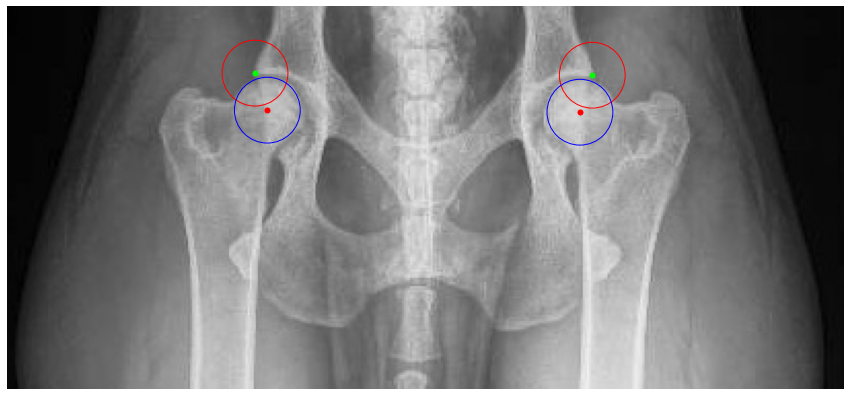

Processing /home/featurize/work/Dataset2/data/Testing/Images/361492.jpeg
head: [[[175  76]]

 [[500  69]]]
center: [[[496 103]]

 [[179 111]]]


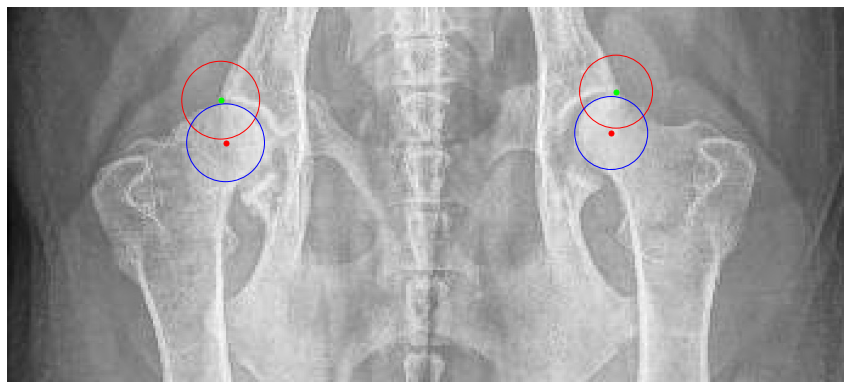

Processing /home/featurize/work/Dataset2/data/Testing/Images/336938.jpeg
head: [[[487 142]]

 [[219 126]]]
center: [[[226 158]]

 [[477 173]]]


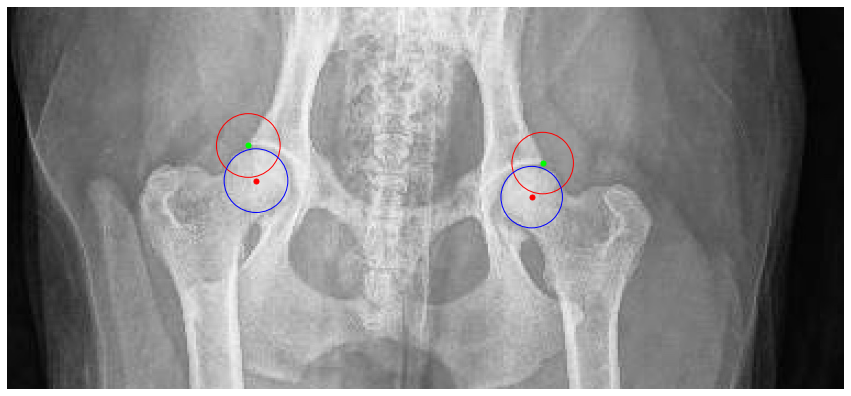

Processing /home/featurize/work/Dataset2/data/Testing/Images/358275.jpeg
head: [[[181  91]]

 [[424  93]]]
center: [[[182 119]]

 [[426 121]]]


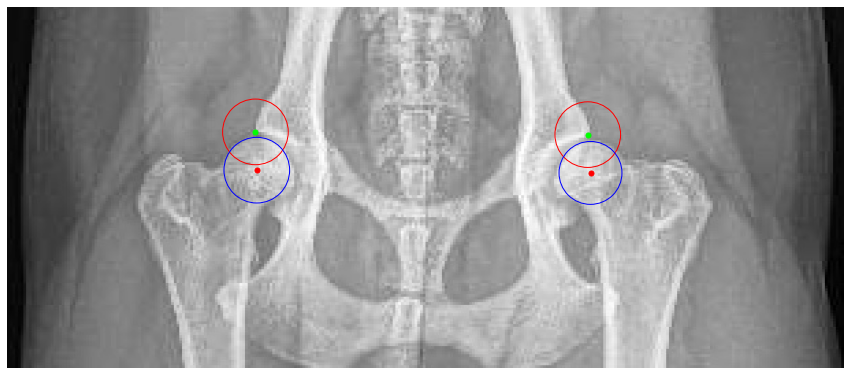

Processing /home/featurize/work/Dataset2/data/Testing/Images/364394.jpeg
head: [[[133  56]]

 [[390  59]]]
center: [[[143  84]]

 [[380  87]]]


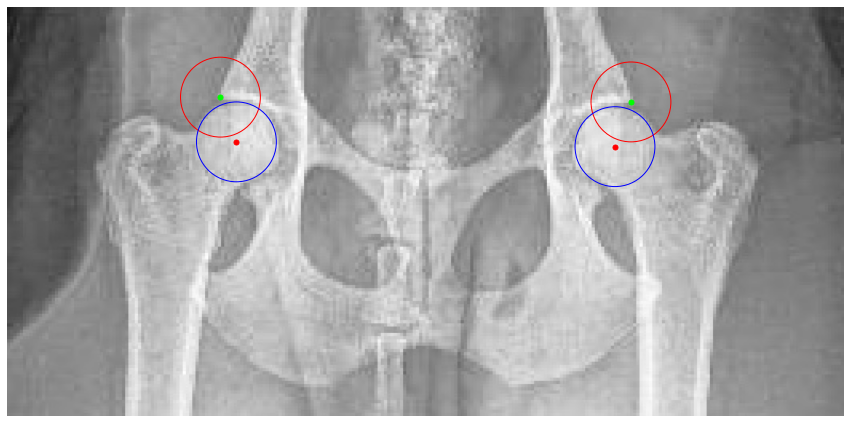

Processing /home/featurize/work/Dataset2/data/Testing/Images/353262.jpg
head: [[[1297  112]]

 [[ 429  262]]]
center: [[[1290  211]]

 [[ 481  348]]]


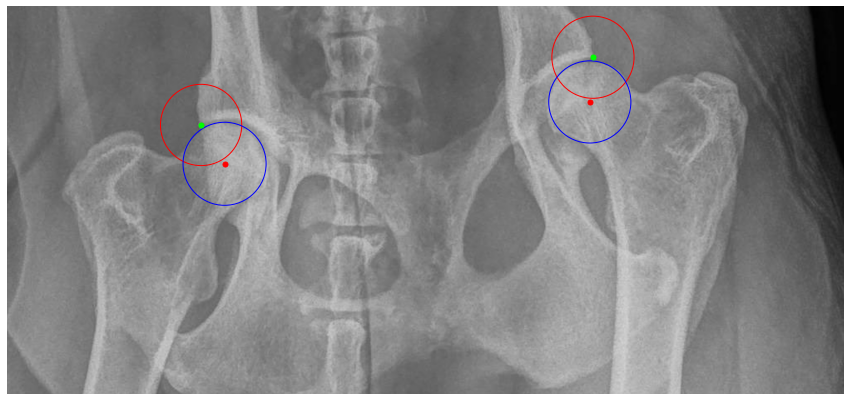

Processing /home/featurize/work/Dataset2/data/Testing/Images/359216.jpeg
head: [[[169  79]]

 [[414  82]]]
center: [[[169 116]]

 [[408 122]]]


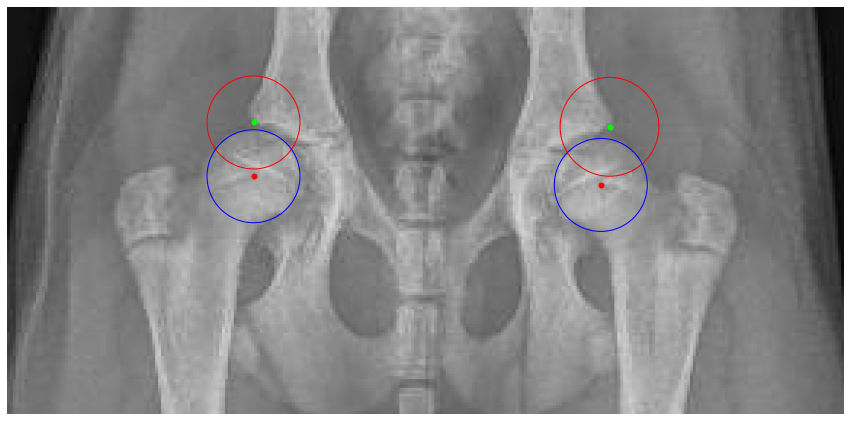

Processing /home/featurize/work/Dataset2/data/Testing/Images/352697.jpeg
head: [[[204 102]]

 [[509 101]]]
center: [[[215 133]]

 [[502 131]]]


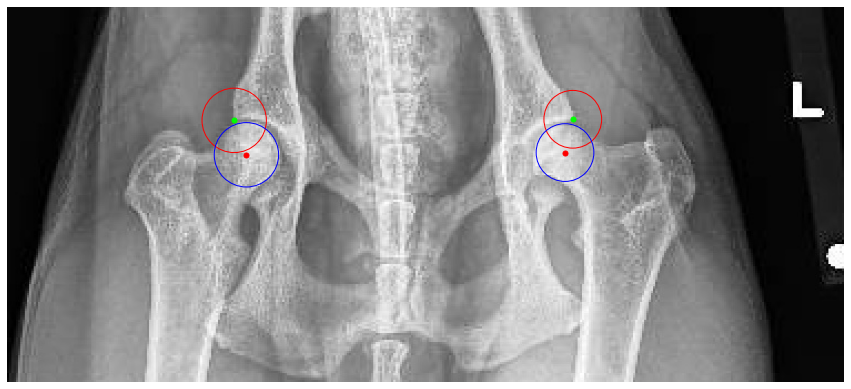

Processing /home/featurize/work/Dataset2/data/Testing/Images/359792.jpeg
head: [[[461 100]]

 [[175  73]]]
center: [[[177 104]]

 [[447 130]]]


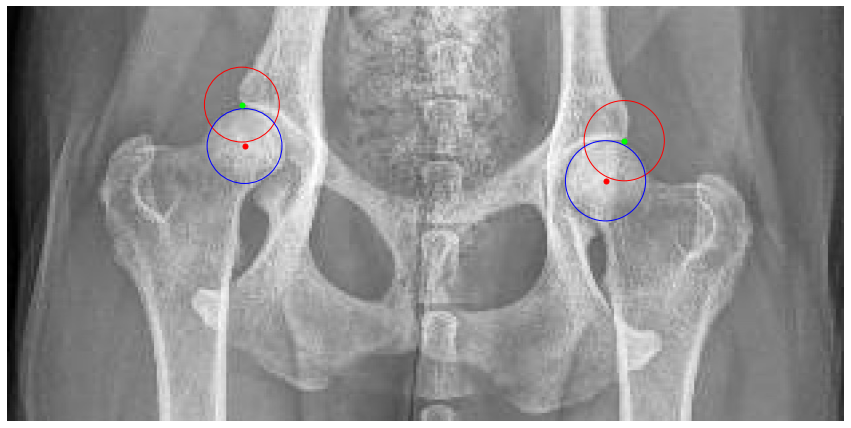

Processing /home/featurize/work/Dataset2/data/Testing/Images/360132.jpeg
head: [[[150  62]]

 [[473  70]]]
center: [[[162  97]]

 [[457 105]]]


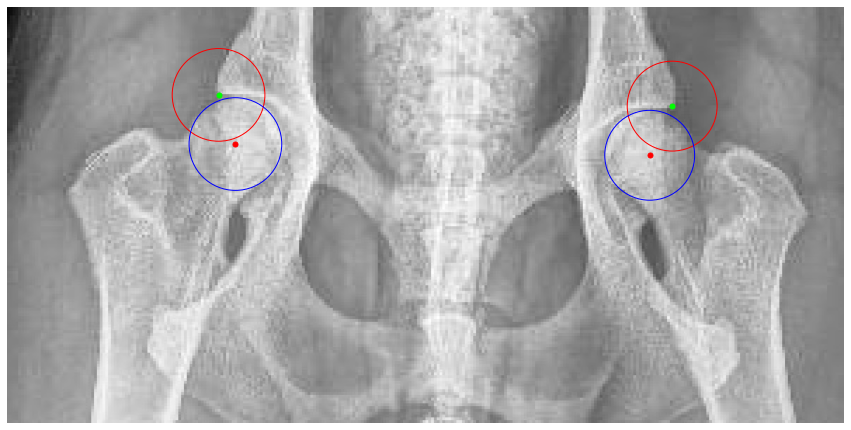

Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg
head: [[[1066  223]]

 [[ 326  123]]]
center: [[[1017  292]]

 [[ 309  202]]]


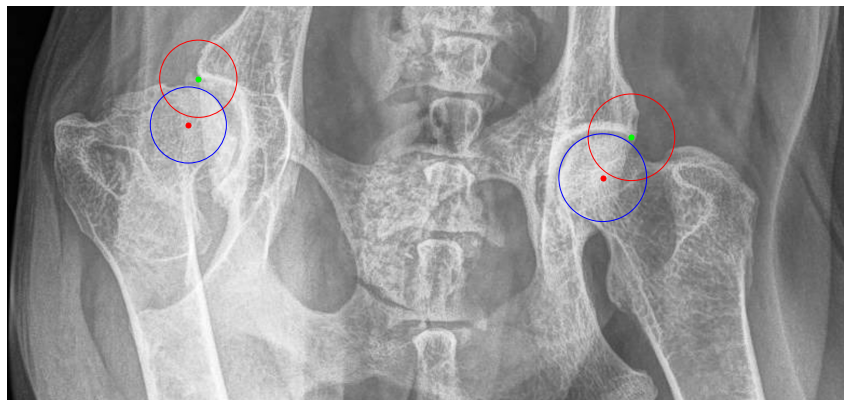

Processing /home/featurize/work/Dataset2/data/Testing/Images/350186.jpeg
head: [[[517 130]]

 [[217 124]]]
center: [[[506 161]]

 [[229 158]]]


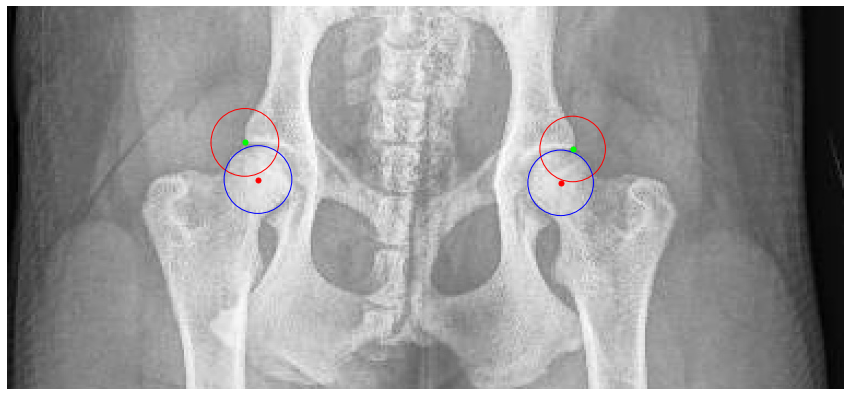

Processing /home/featurize/work/Dataset2/data/Testing/Images/367031.jpg
head: [[[992 134]]

 [[291 147]]]
center: [[[319 225]]

 [[969 213]]]


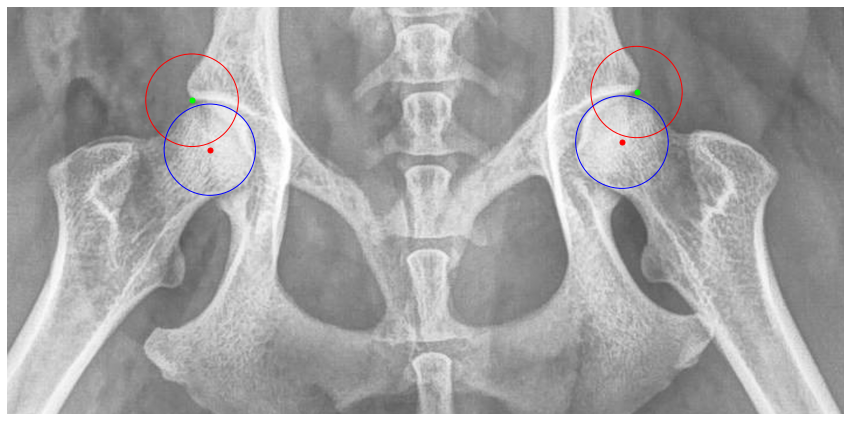

Processing /home/featurize/work/Dataset2/data/Testing/Images/348064.jpeg
head: [[[527 114]]

 [[210 127]]]
center: [[[510 149]]

 [[228 162]]]


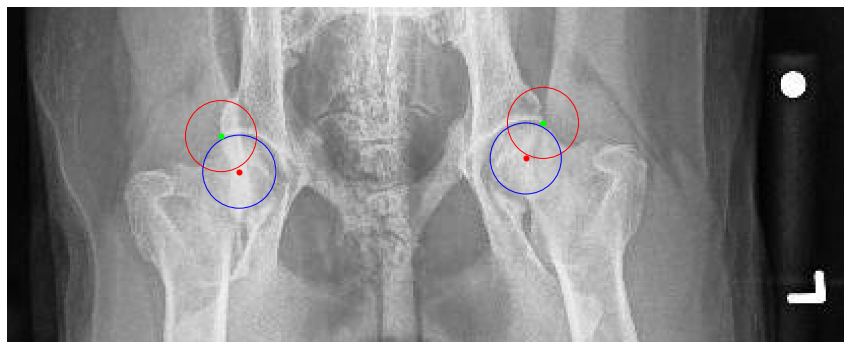

Processing /home/featurize/work/Dataset2/data/Testing/Images/337935.jpeg
head: [[[403 196]]

 [[906 154]]]
center: [[[900 209]]

 [[421 252]]]


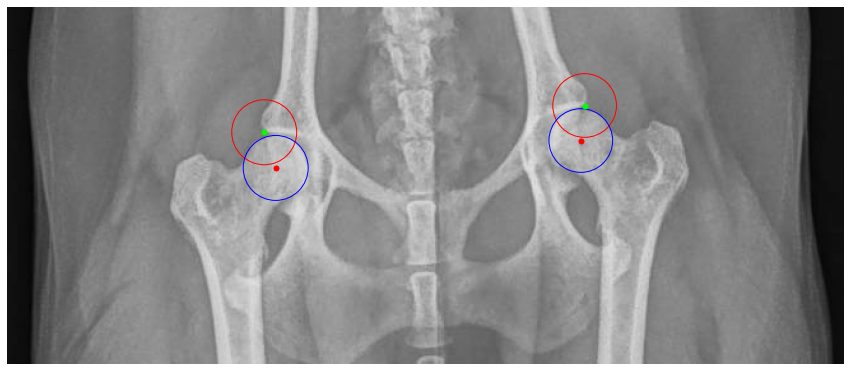

Processing /home/featurize/work/Dataset2/data/Testing/Images/360778.jpeg
head: [[[539 102]]

 [[210  96]]]
center: [[[199 132]]

 [[544 140]]]


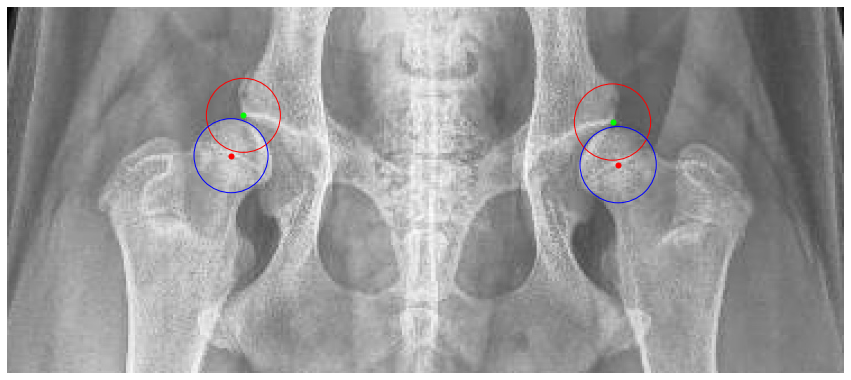

Processing /home/featurize/work/Dataset2/data/Testing/Images/204964.jpg
head: [[[ 327  242]]

 [[1204  434]]]
center: [[[1146  524]]

 [[ 342  338]]]


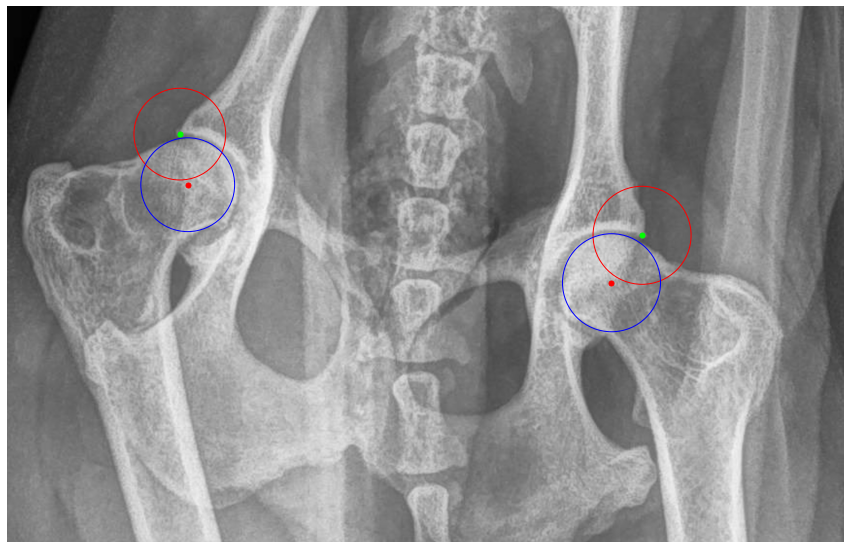

Processing /home/featurize/work/Dataset2/data/Testing/Images/357039.jpeg
head: [[[233 103]]

 [[517  91]]]
center: [[[508 123]]

 [[249 133]]]


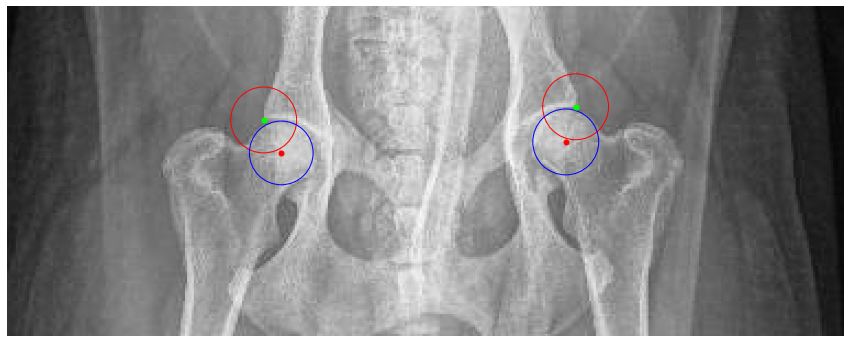

Processing /home/featurize/work/Dataset2/data/Testing/Images/261359.jpeg
head: [[[286  30]]

 [[114  38]]]
center: [[[281  47]]

 [[122  56]]]


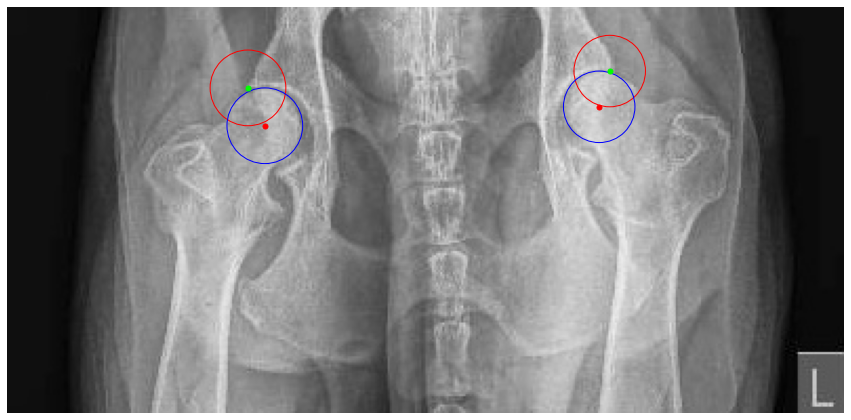

Processing /home/featurize/work/Dataset2/data/Testing/Images/363515.jpeg
head: [[[498  88]]

 [[191  71]]]
center: [[[484 123]]

 [[195 108]]]


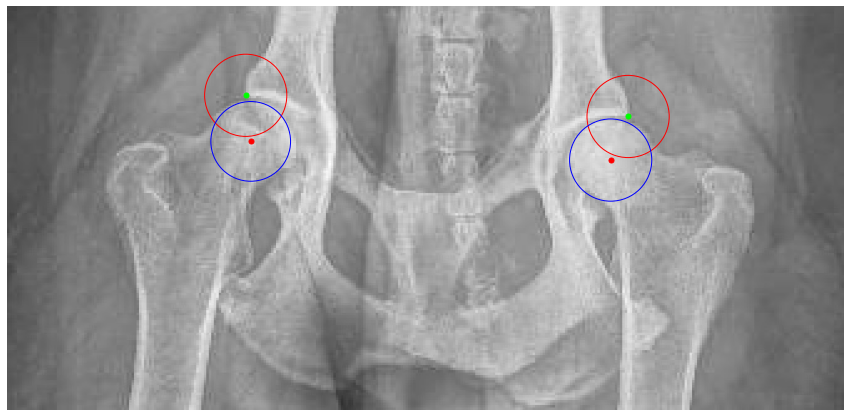

Processing /home/featurize/work/Dataset2/data/Testing/Images/359626.jpeg
head: [[[417  91]]

 [[150  93]]]
center: [[[408 121]]

 [[159 123]]]


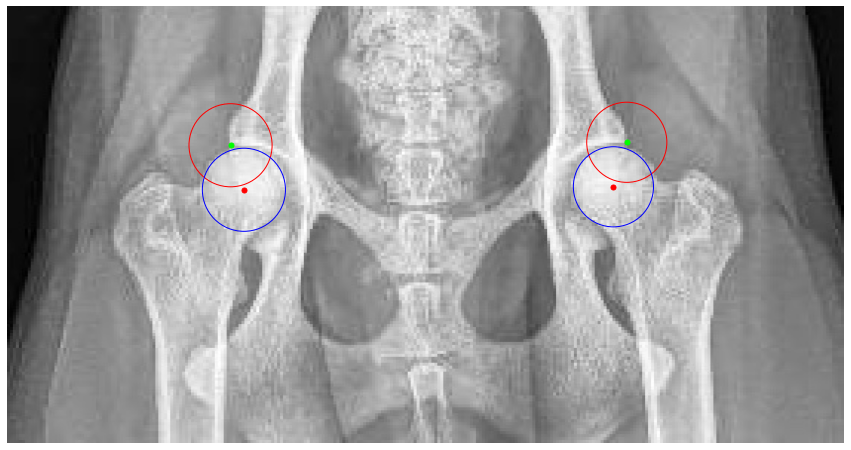

Processing /home/featurize/work/Dataset2/data/Testing/Images/341649.jpeg
head: [[[586 176]]

 [[296 168]]]
center: [[[273 189]]

 [[607 197]]]


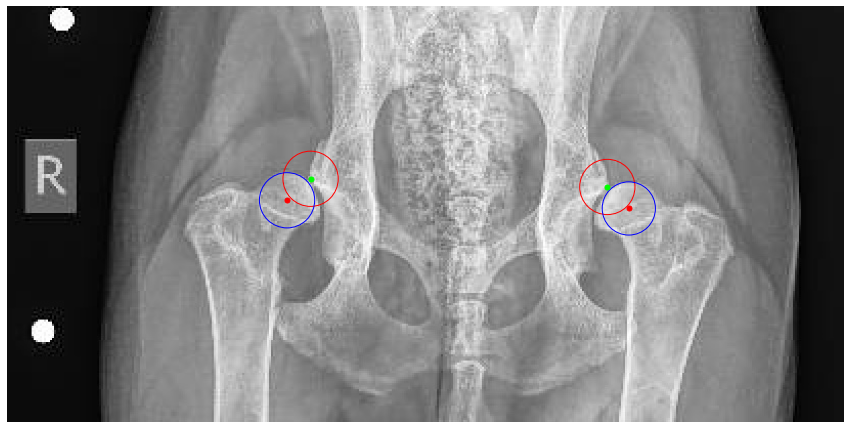

Processing /home/featurize/work/Dataset2/data/Testing/Images/348002.jpeg
head: [[[452  60]]

 [[206  97]]]
center: [[[444  91]]

 [[221 124]]]


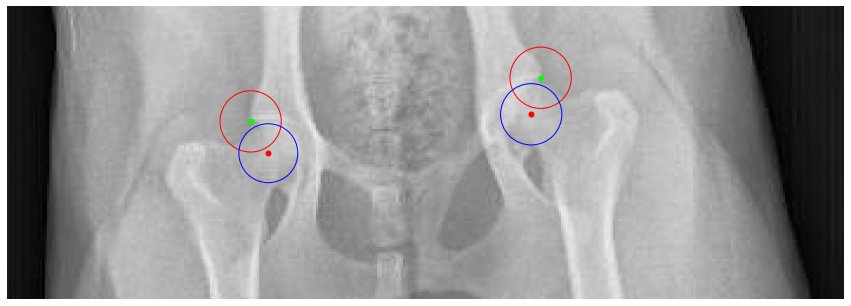

Processing /home/featurize/work/Dataset2/data/Testing/Images/359782.jpeg
head: [[[193  97]]

 [[519  99]]]
center: [[[201 131]]

 [[510 133]]]


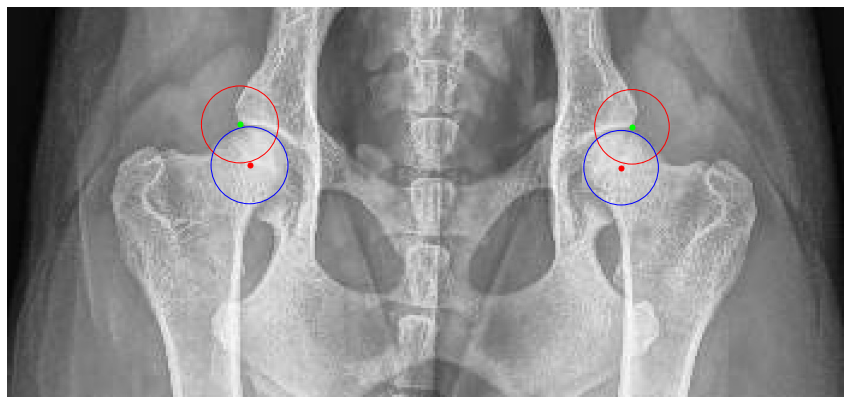

Processing /home/featurize/work/Dataset2/data/Testing/Images/270257.jpeg
head: [[[282  93]]

 [[588  66]]]
center: [[[294 127]]

 [[590 101]]]


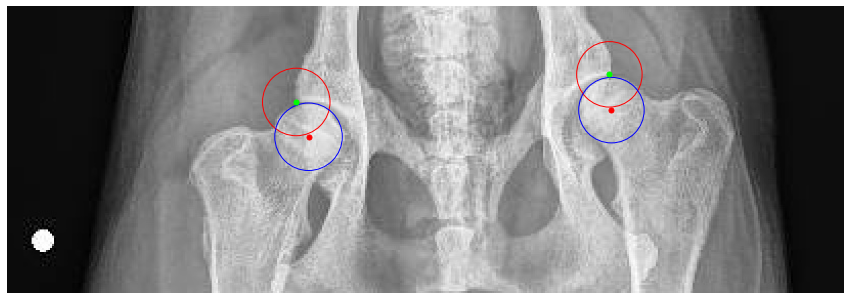

Processing /home/featurize/work/Dataset2/data/Testing/Images/350556.jpeg
head: [[[187  86]]

 [[464  68]]]
center: [[[193 116]]

 [[470  97]]]


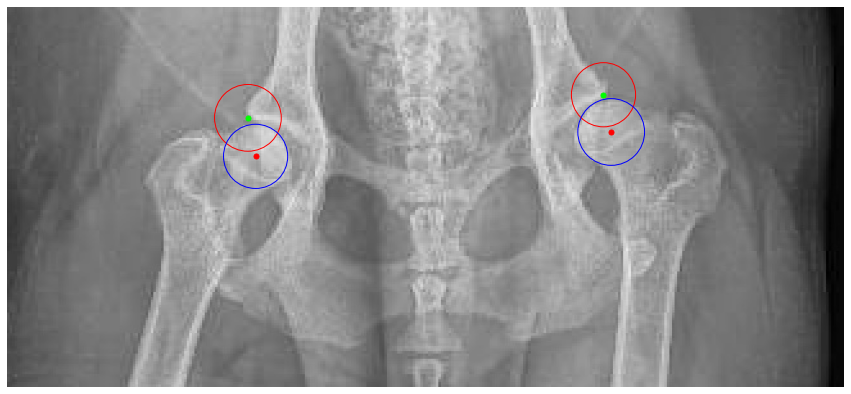

Processing /home/featurize/work/Dataset2/data/Testing/Images/360678.jpg
head: [[[1074  125]]

 [[ 287  131]]]
center: [[[1044  211]]

 [[ 321  217]]]


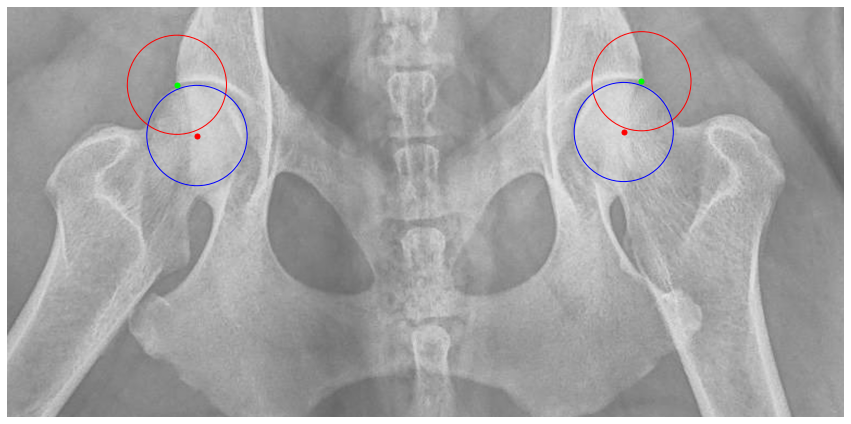

Processing /home/featurize/work/Dataset2/data/Testing/Images/364276.jpeg
head: [[[177 126]]

 [[460 111]]]
center: [[[449 152]]

 [[195 166]]]


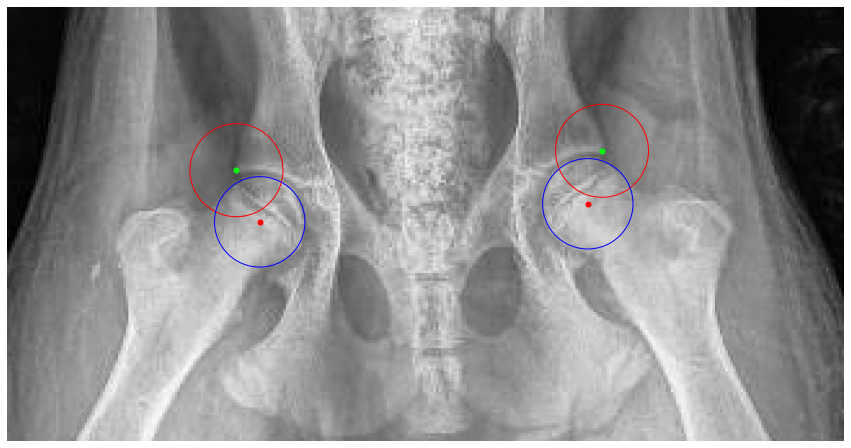

Processing /home/featurize/work/Dataset2/data/Testing/Images/349607.jpeg
head: [[[517 117]]

 [[204 127]]]
center: [[[213 159]]

 [[510 149]]]


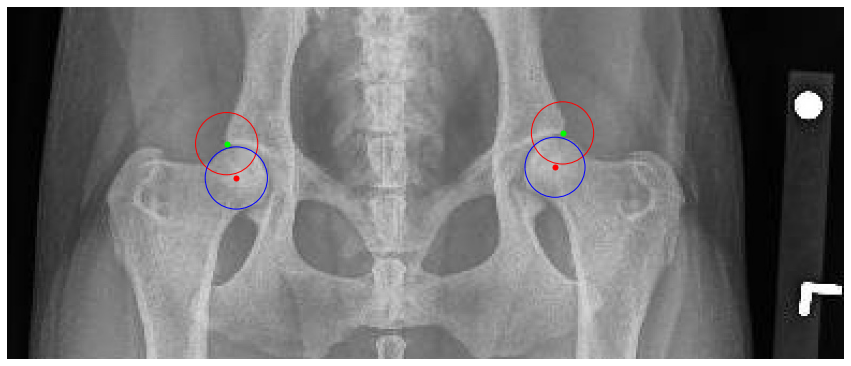

Processing /home/featurize/work/Dataset2/data/Testing/Images/302735.jpeg
head: [[[564 116]]

 [[294 110]]]
center: [[[551 145]]

 [[307 140]]]


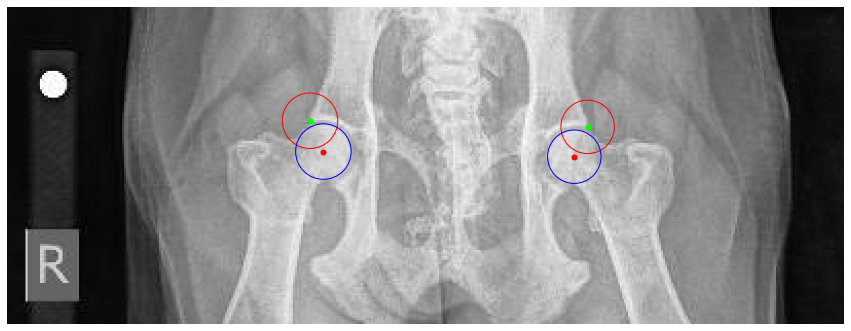

Processing /home/featurize/work/Dataset2/data/Testing/Images/361188.jpeg
head: [[[155  77]]

 [[420  53]]]
center: [[[169 110]]

 [[413  91]]]


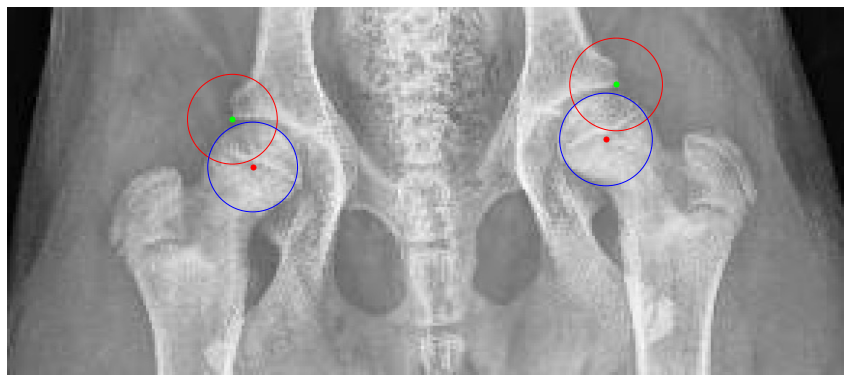

Processing /home/featurize/work/Dataset2/data/Testing/Images/335450.jpeg
head: [[[498 137]]

 [[246 120]]]
center: [[[485 165]]

 [[248 150]]]


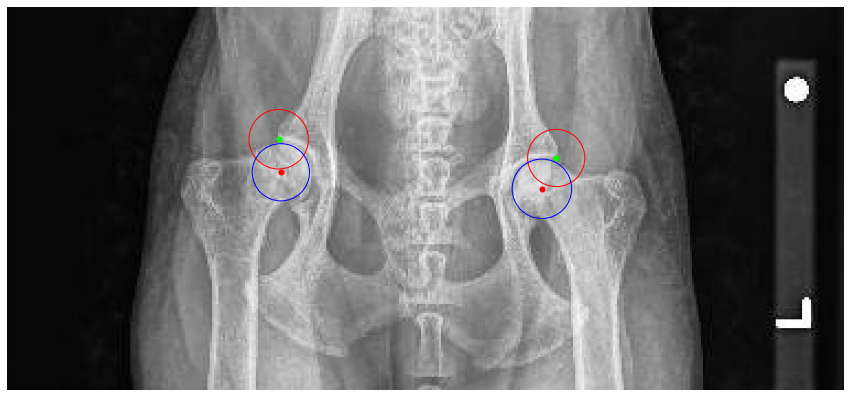

Processing /home/featurize/work/Dataset2/data/Testing/Images/352456.jpeg
head: [[[503 106]]

 [[220  97]]]
center: [[[493 139]]

 [[229 130]]]


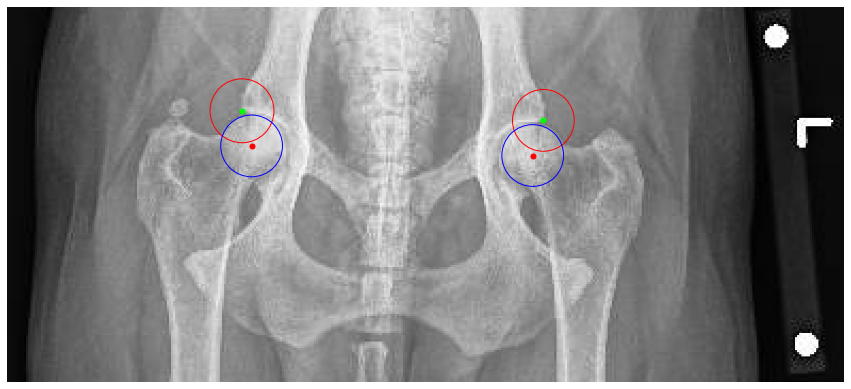

Processing /home/featurize/work/Dataset2/data/Testing/Images/314200.jpeg
head: [[[237 126]]

 [[543 159]]]
center: [[[241 165]]

 [[529 195]]]


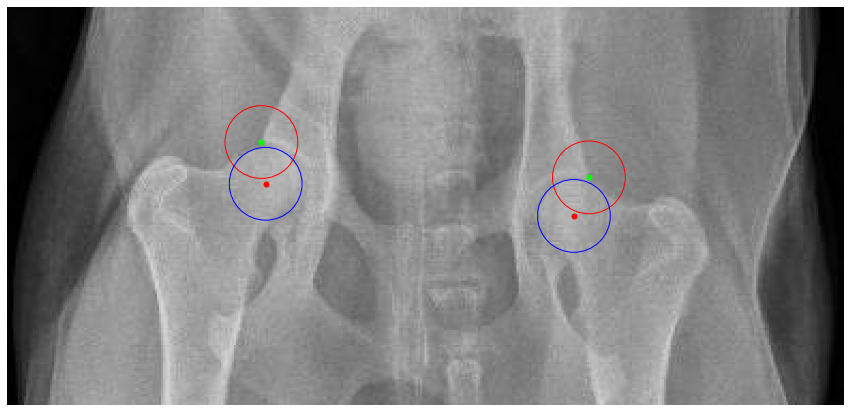

Processing /home/featurize/work/Dataset2/data/Testing/Images/351971.jpg
head: [[[ 360  224]]

 [[1140  236]]]
center: [[[ 385  319]]

 [[1087  329]]]


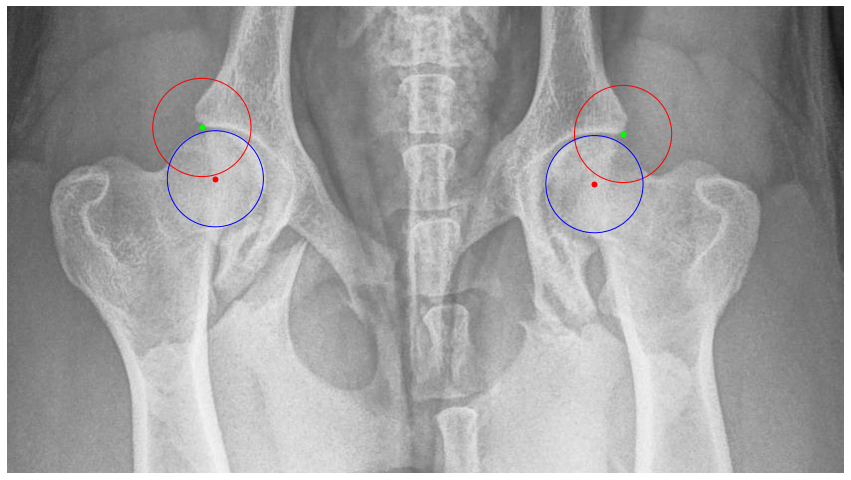

Processing /home/featurize/work/Dataset2/data/Testing/Images/339041.jpeg
head: [[[224 106]]

 [[509 107]]]
center: [[[224 136]]

 [[517 137]]]


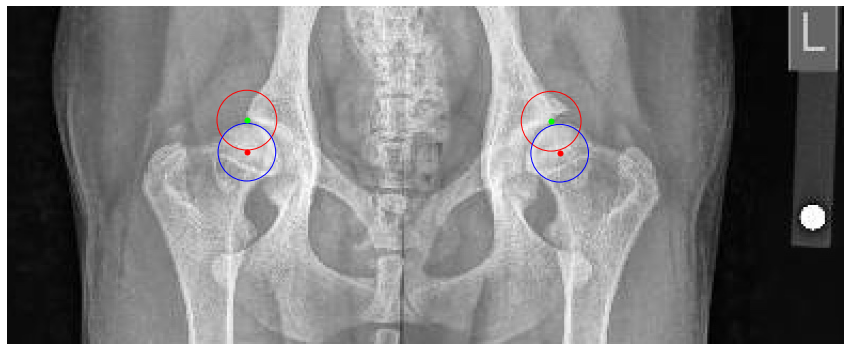

Processing /home/featurize/work/Dataset2/data/Testing/Images/332727.jpeg
head: [[[486 138]]

 [[199 116]]]
center: [[[474 170]]

 [[205 150]]]


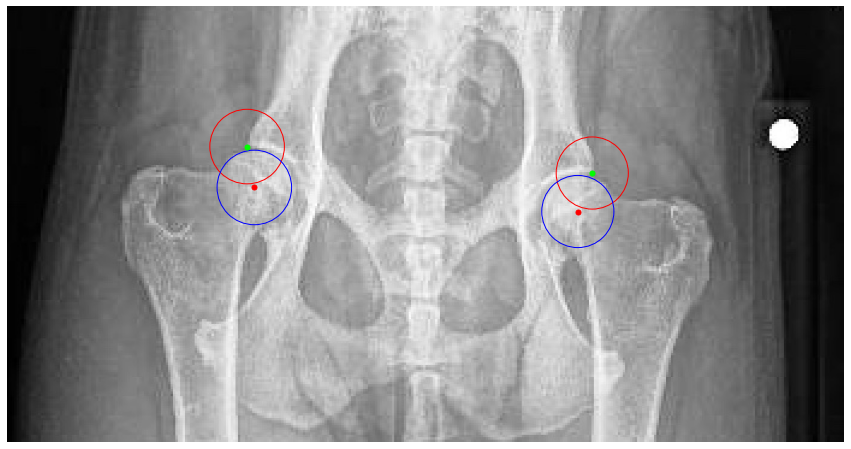

Processing /home/featurize/work/Dataset2/data/Testing/Images/351666.jpg
head: [[[1276  267]]

 [[ 351  260]]]
center: [[[ 376  364]]

 [[1252  362]]]


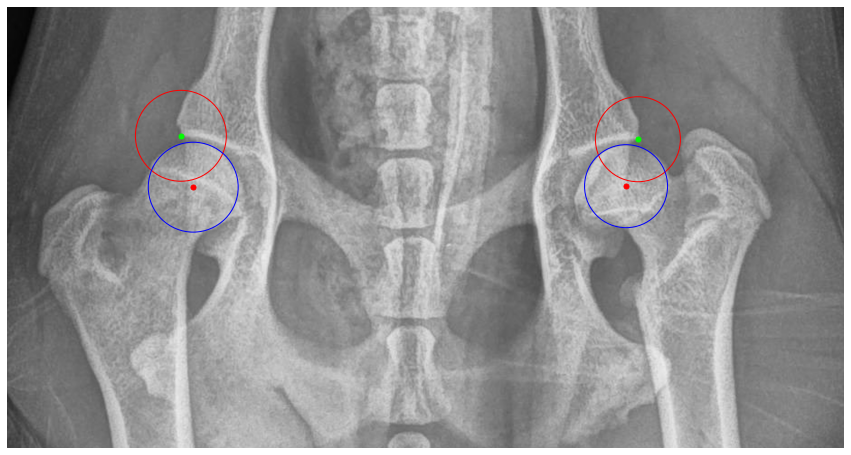

Processing /home/featurize/work/Dataset2/data/Testing/Images/351294.jpeg
head: [[[459  77]]

 [[190  88]]]
center: [[[452 108]]

 [[197 119]]]


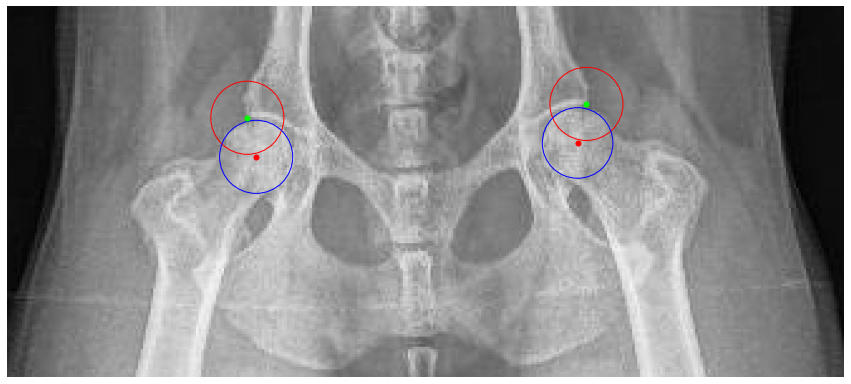

Processing /home/featurize/work/Dataset2/data/Testing/Images/288625.jpeg
head: [[[518  88]]

 [[254  76]]]
center: [[[261 106]]

 [[509 120]]]


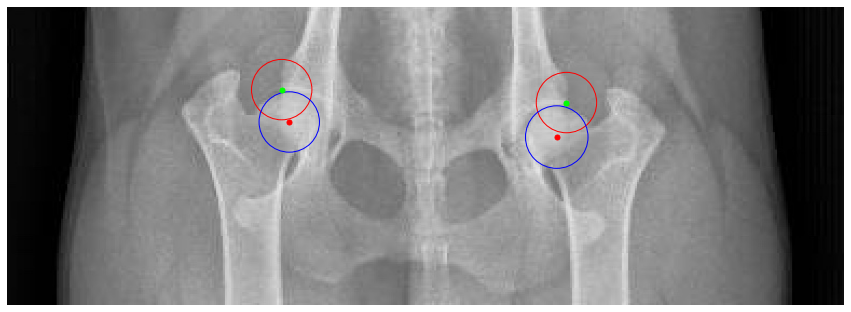

Processing /home/featurize/work/Dataset2/data/Testing/Images/357332.jpeg
head: [[[503  71]]

 [[208  67]]]
center: [[[490 103]]

 [[220 100]]]


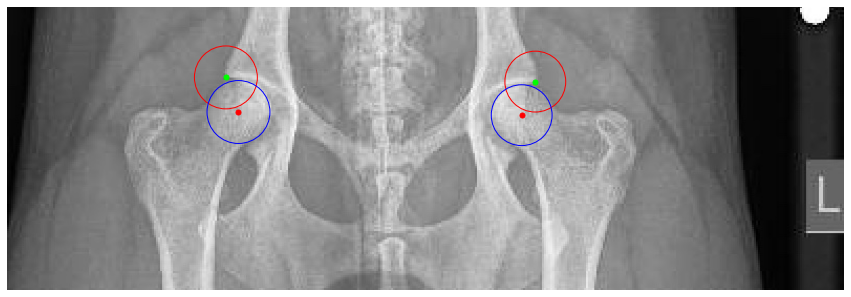

Processing /home/featurize/work/Dataset2/data/Testing/Images/345281.jpeg
head: [[[209 115]]

 [[510 108]]]
center: [[[221 148]]

 [[501 143]]]


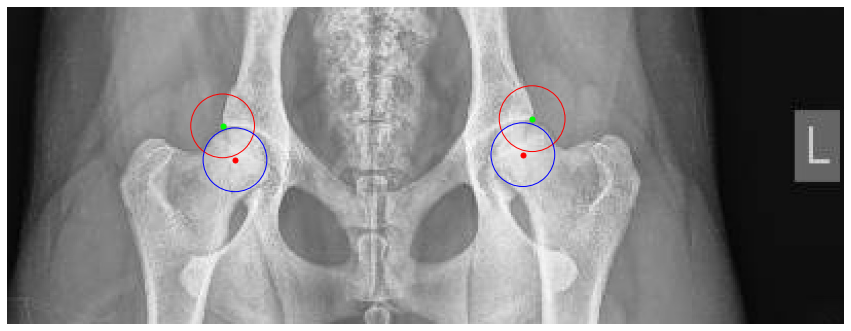

Processing /home/featurize/work/Dataset2/data/Testing/Images/364123.jpeg
head: [[[150  73]]

 [[433  67]]]
center: [[[164 103]]

 [[423  99]]]


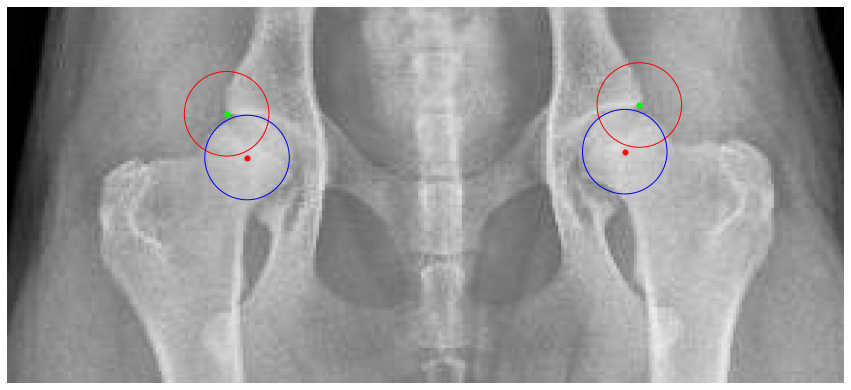

Processing /home/featurize/work/Dataset2/data/Testing/Images/332635.jpeg
head: [[[519 136]]

 [[268 124]]]
center: [[[509 165]]

 [[273 154]]]


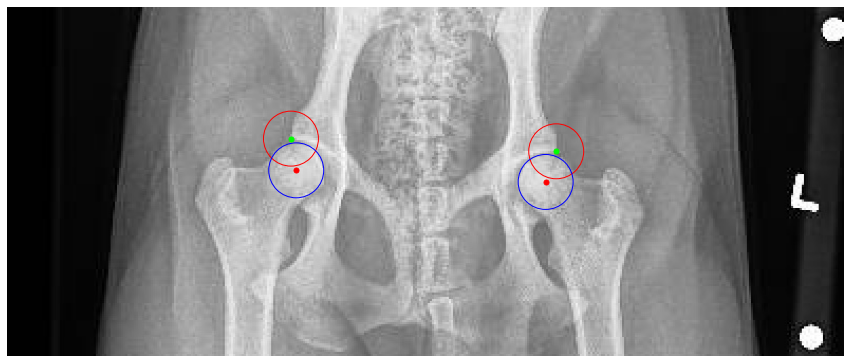

Processing /home/featurize/work/Dataset2/data/Testing/Images/355423.jpeg
head: [[[549 162]]

 [[198 140]]]
center: [[[207 181]]

 [[533 200]]]


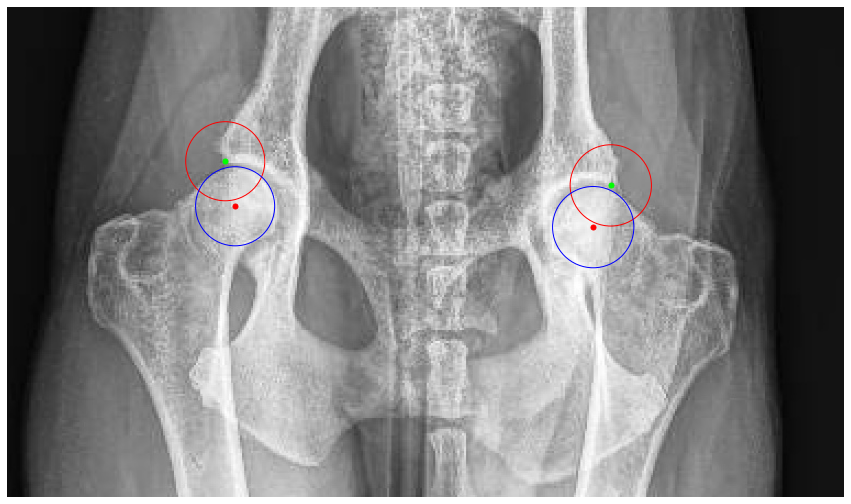

Processing /home/featurize/work/Dataset2/data/Testing/Images/360391.jpeg
head: [[[192  97]]

 [[523 105]]]
center: [[[526 137]]

 [[195 130]]]


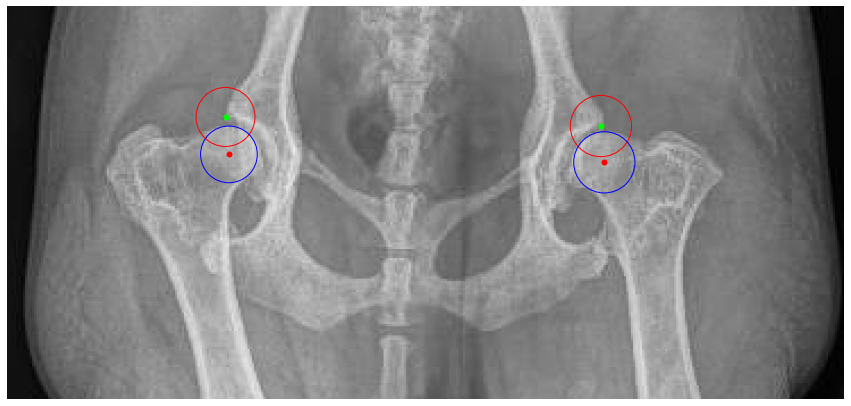

Processing /home/featurize/work/Dataset2/data/Testing/Images/366863.jpeg
head: [[[178  65]]

 [[468  60]]]
center: [[[460  94]]

 [[191  96]]]


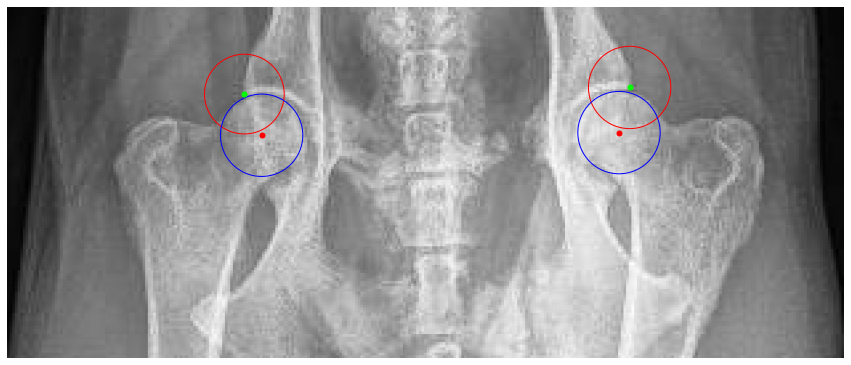

Processing /home/featurize/work/Dataset2/data/Testing/Images/353028.jpeg
head: [[[180 127]]

 [[490 114]]]
center: [[[191 161]]

 [[487 146]]]


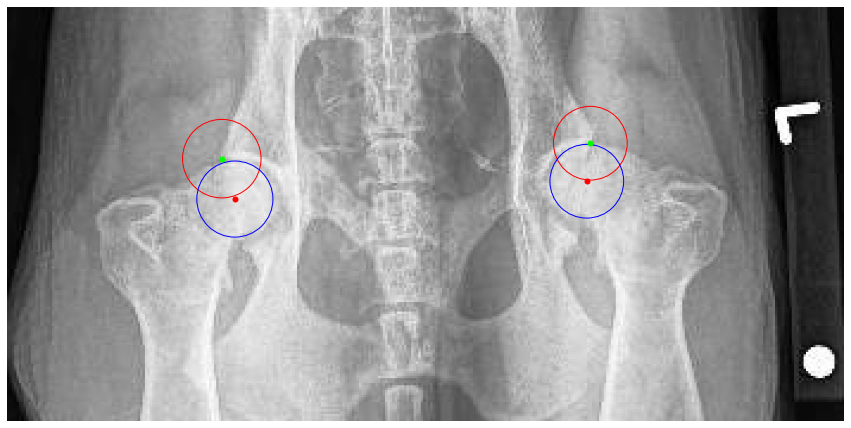

Processing /home/featurize/work/Dataset2/data/Testing/Images/358586.jpeg
head: [[[334  56]]

 [[120  53]]]
center: [[[332  82]]

 [[120  79]]]


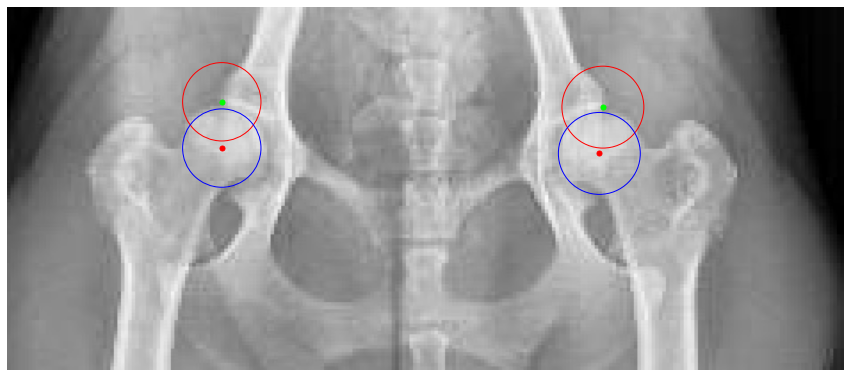

Processing /home/featurize/work/Dataset2/data/Testing/Images/357885.jpeg
head: [[[489  98]]

 [[200  95]]]
center: [[[197 129]]

 [[483 133]]]


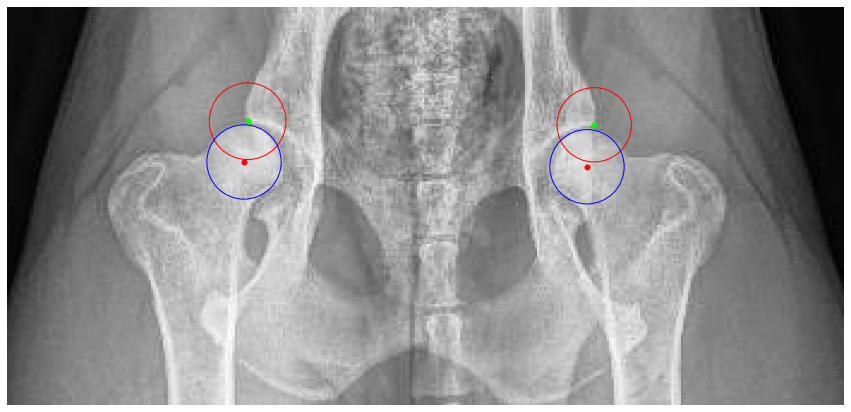

Processing /home/featurize/work/Dataset2/data/Testing/Images/360713.jpeg
head: [[[195  87]]

 [[486  88]]]
center: [[[185 120]]

 [[497 116]]]


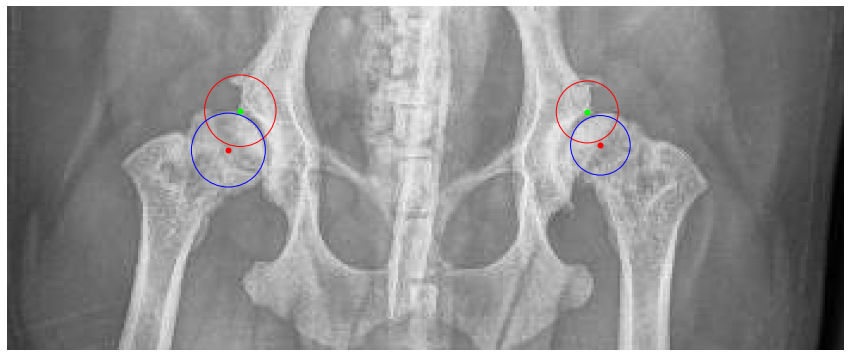

Processing /home/featurize/work/Dataset2/data/Testing/Images/355048.jpeg
head: [[[536 135]]

 [[244 133]]]
center: [[[549 168]]

 [[213 146]]]


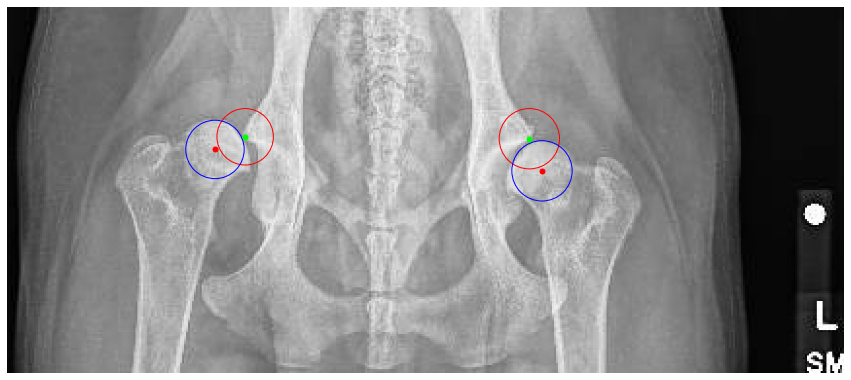

Processing /home/featurize/work/Dataset2/data/Testing/Images/328125.jpeg
head: [[[482 108]]

 [[241  92]]]
center: [[[470 135]]

 [[244 121]]]


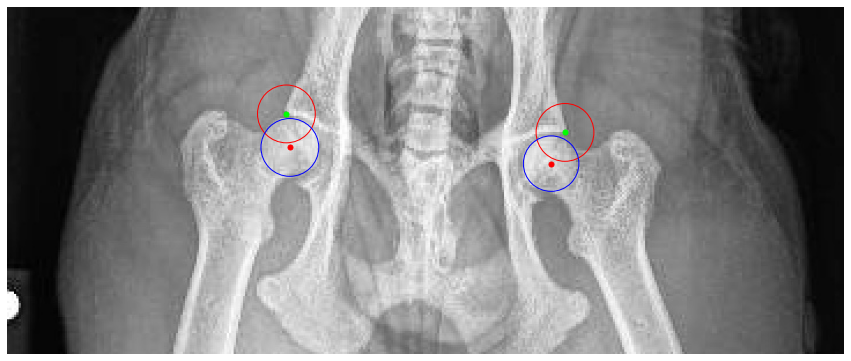

Processing /home/featurize/work/Dataset2/data/Testing/Images/366596.jpeg
head: [[[200  98]]

 [[617 100]]]
center: [[[209 152]]

 [[617 155]]]


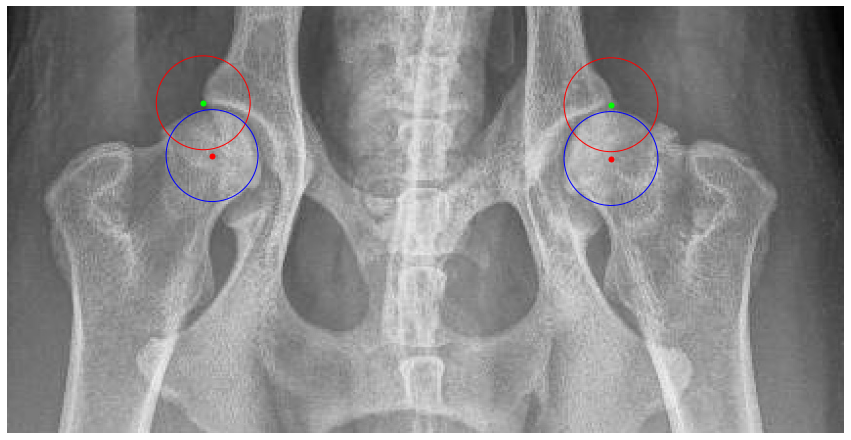

Processing /home/featurize/work/Dataset2/data/Testing/Images/274791.jpeg
head: [[[555 164]]

 [[265 149]]]
center: [[[542 195]]

 [[273 182]]]


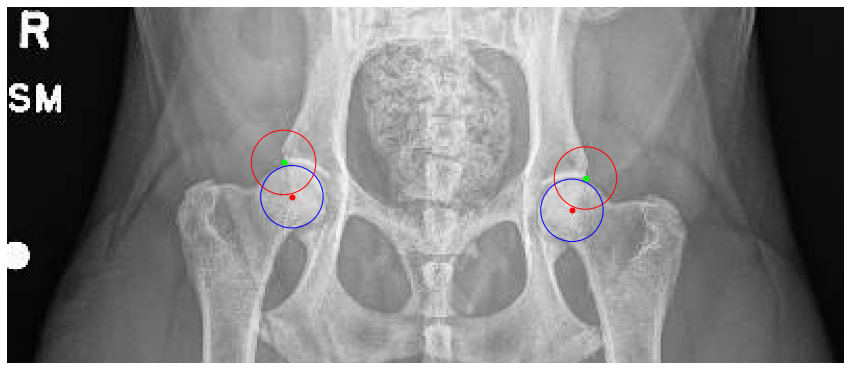

Processing /home/featurize/work/Dataset2/data/Testing/Images/361394.jpeg
head: [[[407  60]]

 [[135  63]]]
center: [[[145  95]]

 [[400  92]]]


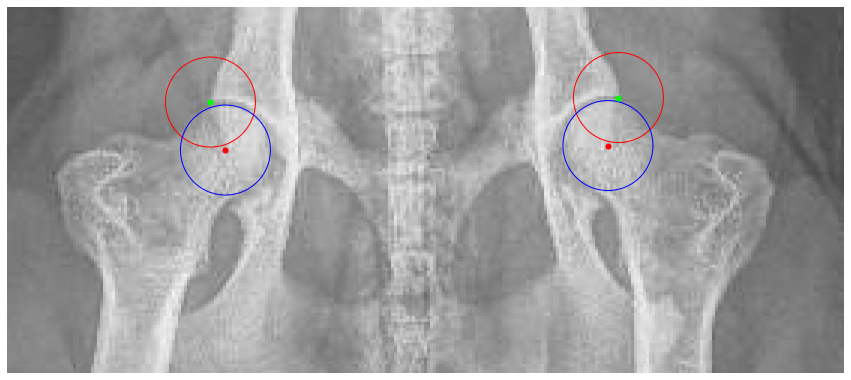

Processing /home/featurize/work/Dataset2/data/Testing/Images/355416.jpeg
head: [[[175  64]]

 [[493  59]]]
center: [[[486  95]]

 [[184 100]]]


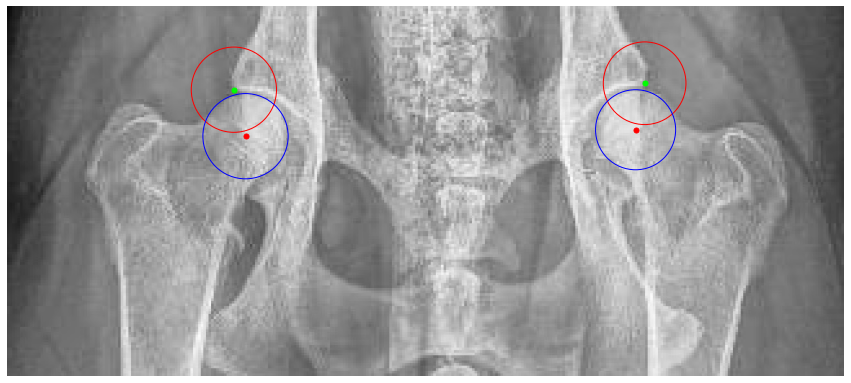

Processing /home/featurize/work/Dataset2/data/Testing/Images/361506.jpeg
head: [[[173  81]]

 [[482  81]]]
center: [[[168 114]]

 [[492 114]]]


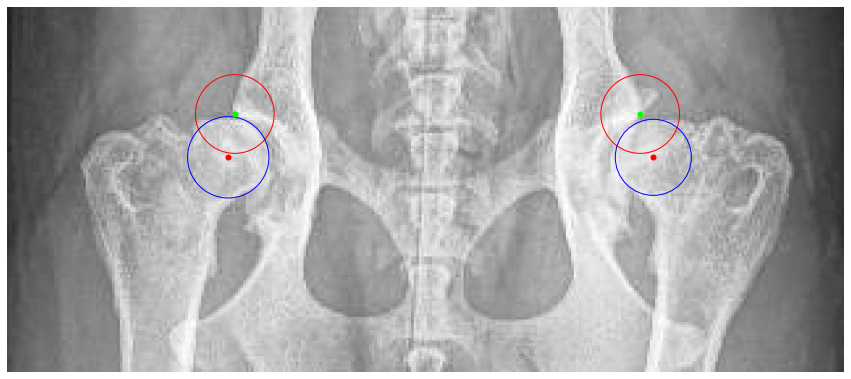

Processing /home/featurize/work/Dataset2/data/Testing/Images/354095.jpeg
head: [[[143  76]]

 [[429  45]]]
center: [[[158 107]]

 [[439  75]]]


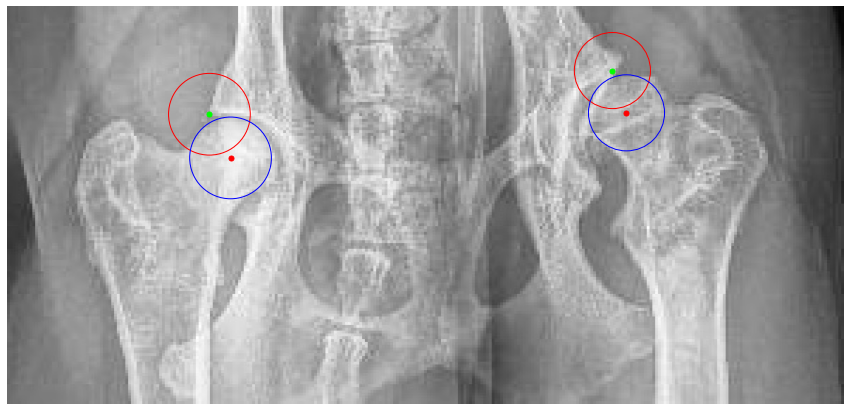

Processing /home/featurize/work/Dataset2/data/Testing/Images/331722.jpeg
head: [[[348 152]]

 [[666 128]]]
center: [[[660 161]]

 [[363 186]]]


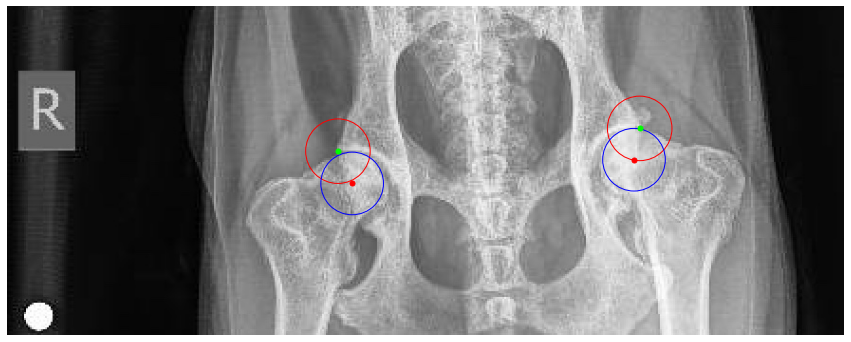

Processing /home/featurize/work/Dataset2/data/Testing/Images/353949.jpg
head: [[[1308  283]]

 [[ 396  221]]]
center: [[[1300  382]]

 [[ 363  303]]]


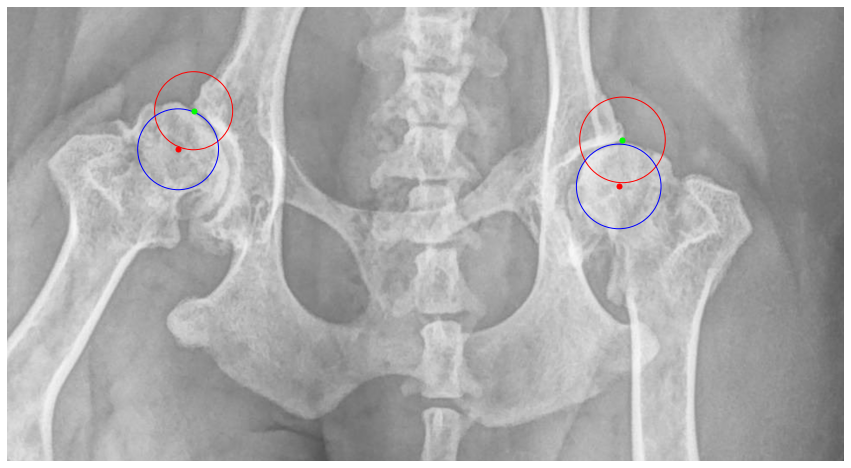

Processing /home/featurize/work/Dataset2/data/Testing/Images/351595.jpeg
head: [[[458 130]]

 [[183 106]]]
center: [[[444 160]]

 [[178 137]]]


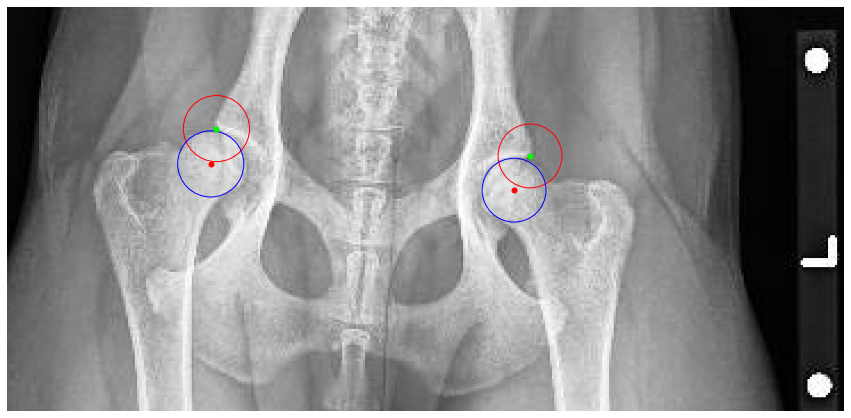

Processing /home/featurize/work/Dataset2/data/Testing/Images/349667.jpeg
head: [[[214 101]]

 [[512 112]]]
center: [[[498 149]]

 [[220 136]]]


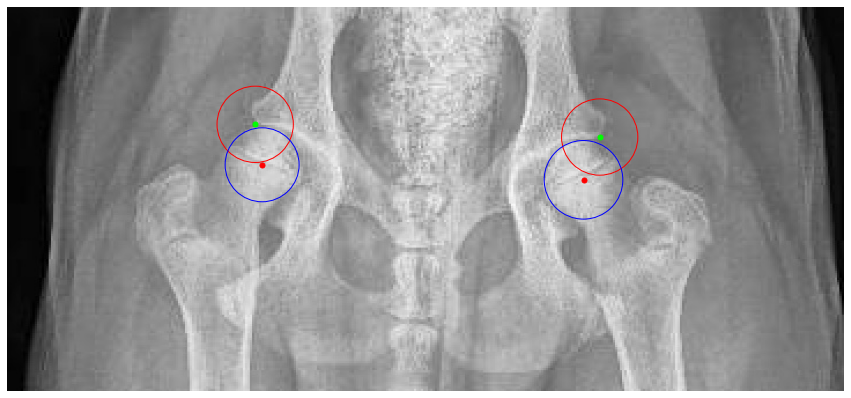

Processing /home/featurize/work/Dataset2/data/Testing/Images/353433.jpeg
head: [[[528 116]]

 [[197 118]]]
center: [[[520 155]]

 [[209 157]]]


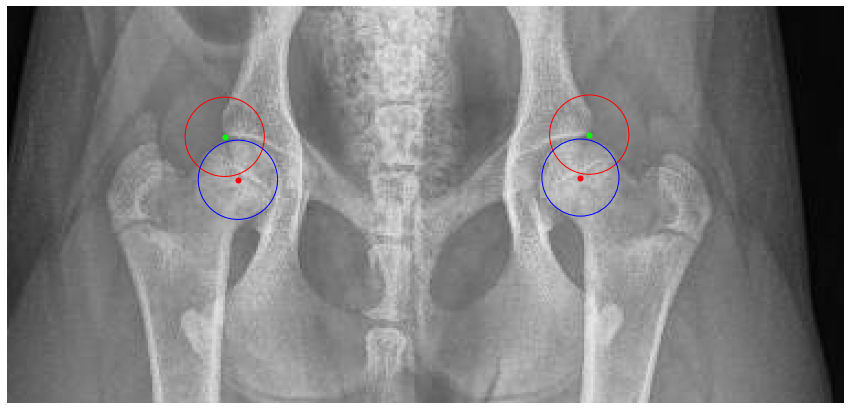

Processing /home/featurize/work/Dataset2/data/Testing/Images/325050.jpg
head: [[[1158   94]]

 [[ 366  141]]]
center: [[[1140  185]]

 [[ 392  233]]]


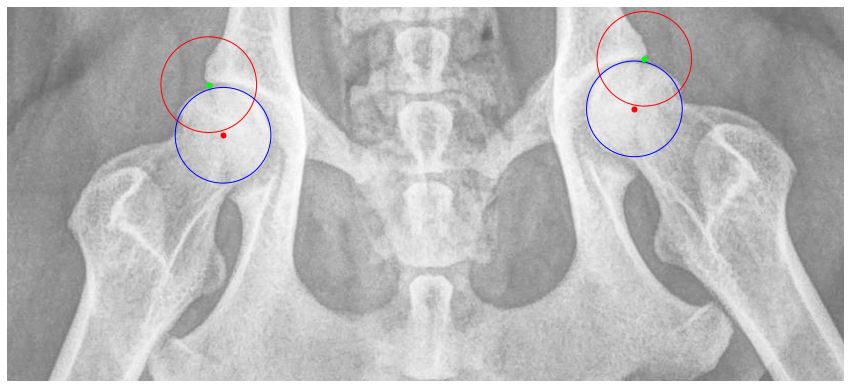

Processing /home/featurize/work/Dataset2/data/Testing/Images/347694.jpeg
head: [[[199 110]]

 [[498 133]]]
center: [[[193 143]]

 [[502 165]]]


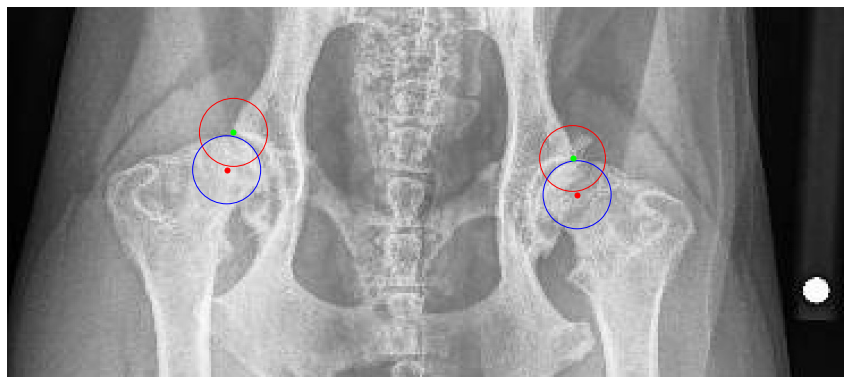

Processing /home/featurize/work/Dataset2/data/Testing/Images/354826.jpg
head: [[[ 393  186]]

 [[1116  129]]]
center: [[[ 417  267]]

 [[1109  213]]]


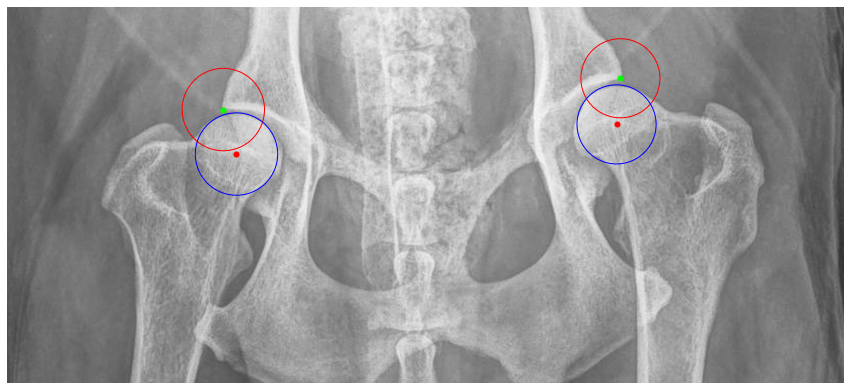

Processing /home/featurize/work/Dataset2/data/Testing/Images/346249.jpg
head: [[[1061  214]]

 [[ 316  154]]]
center: [[[1031  299]]

 [[ 346  238]]]


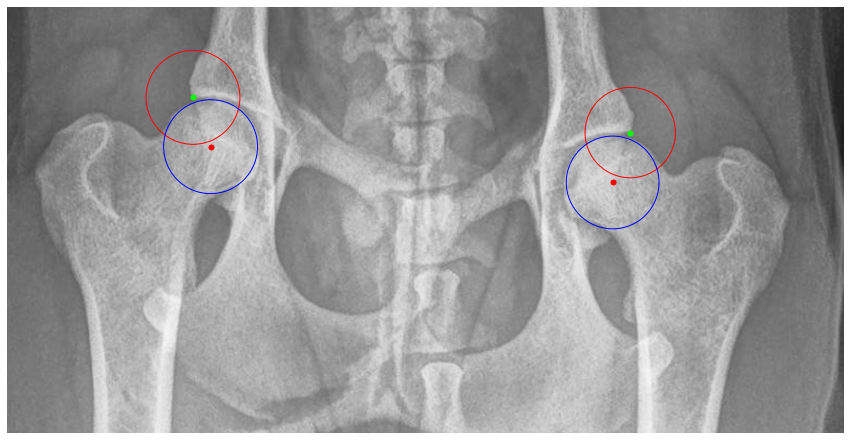

Processing /home/featurize/work/Dataset2/data/Testing/Images/357623.jpg
head: [[[ 324  214]]

 [[1064  187]]]
center: [[[ 362  303]]

 [[1037  279]]]


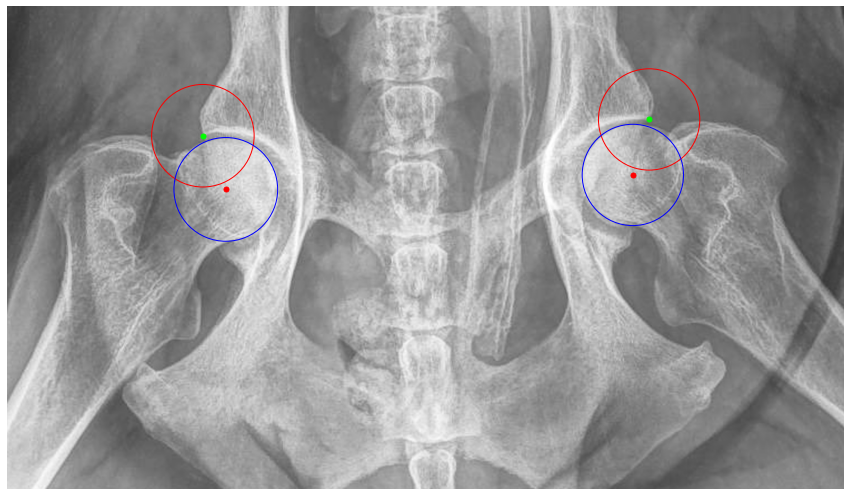

Processing /home/featurize/work/Dataset2/data/Testing/Images/357265.jpeg
head: [[[547 172]]

 [[204 160]]]
center: [[[211 198]]

 [[538 208]]]


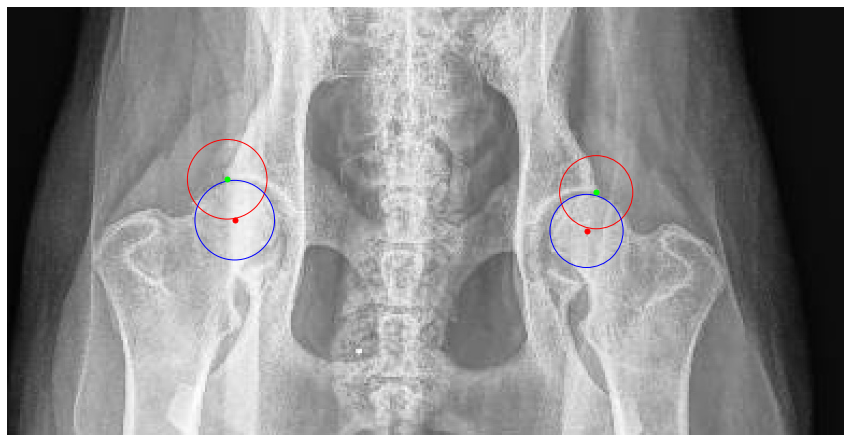

Processing /home/featurize/work/Dataset2/data/Testing/Images/353330.jpeg
head: [[[511 123]]

 [[206 101]]]
center: [[[504 159]]

 [[191 134]]]


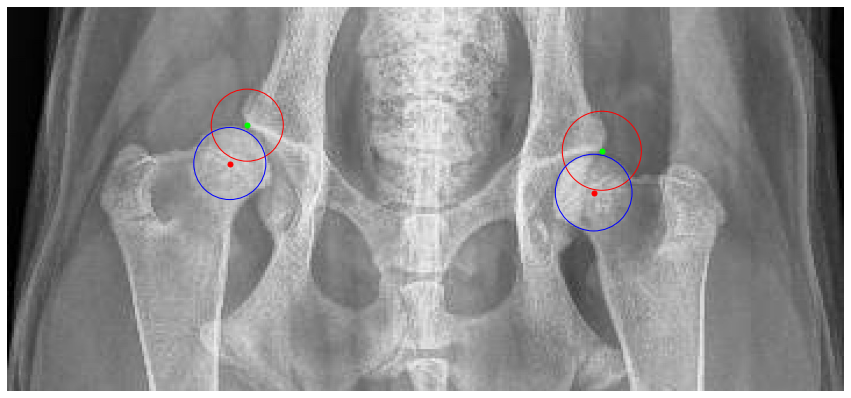

Processing /home/featurize/work/Dataset2/data/Testing/Images/363860.jpeg
head: [[[141 100]]

 [[484 115]]]
center: [[[151 134]]

 [[471 150]]]


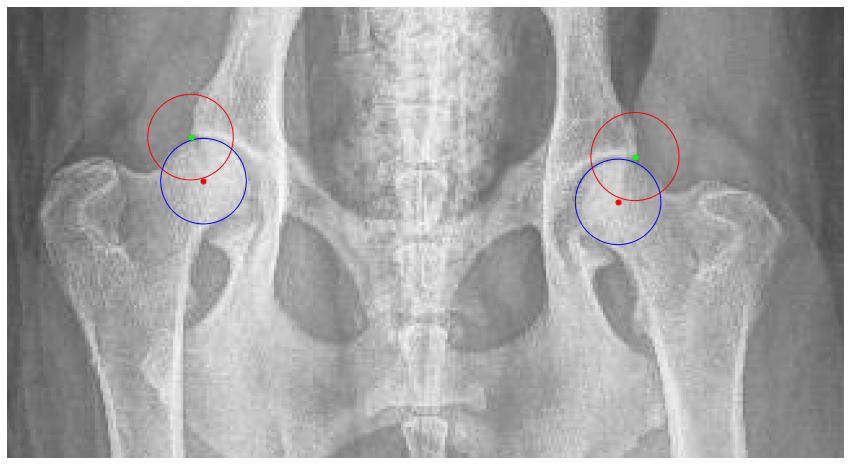

Processing /home/featurize/work/Dataset2/data/Testing/Images/325038.jpeg
head: [[[591 121]]

 [[291 122]]]
center: [[[579 154]]

 [[302 154]]]


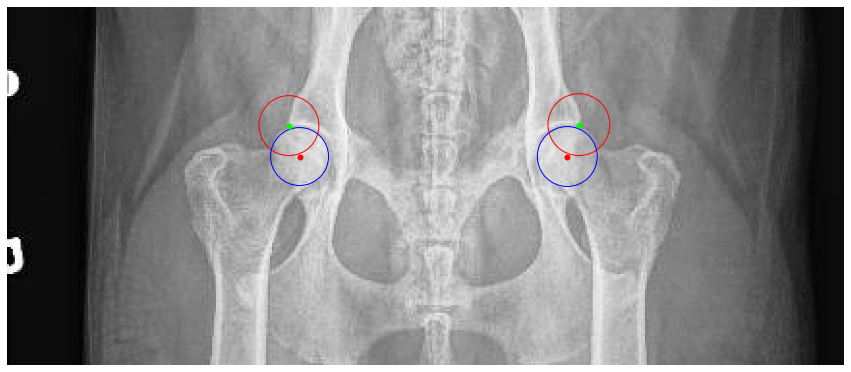

Processing /home/featurize/work/Dataset2/data/Testing/Images/357970.jpeg
head: [[[454 103]]

 [[195  88]]]
center: [[[192 121]]

 [[445 134]]]


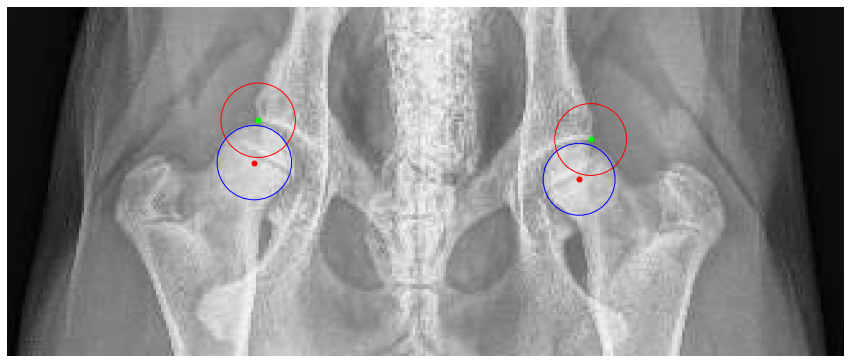

Processing /home/featurize/work/Dataset2/data/Testing/Images/268505.jpeg
head: [[[265  59]]

 [[586 104]]]
center: [[[567 136]]

 [[274  96]]]


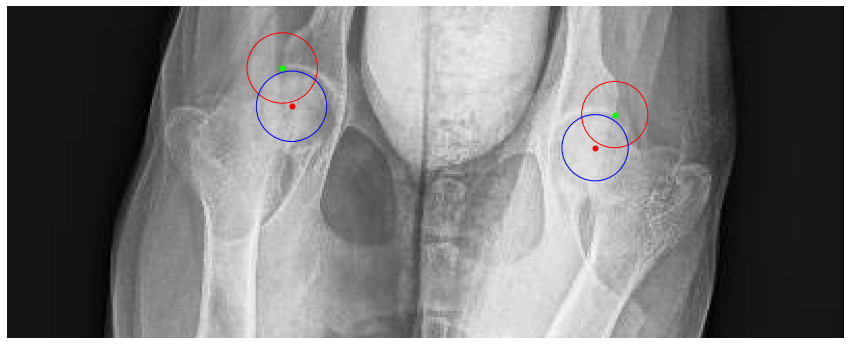

Processing /home/featurize/work/Dataset2/data/Testing/Images/349744.jpeg
head: [[[510  82]]

 [[238  78]]]
center: [[[500 112]]

 [[246 107]]]


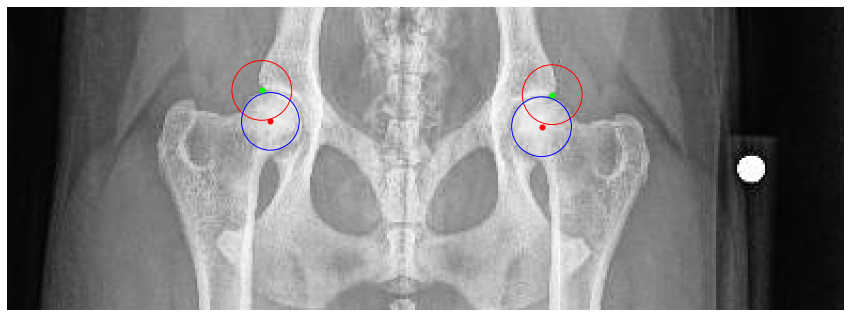

Processing /home/featurize/work/Dataset2/data/Testing/Images/351103.jpeg
head: [[[438  79]]

 [[186  82]]]
center: [[[432 110]]

 [[191 112]]]


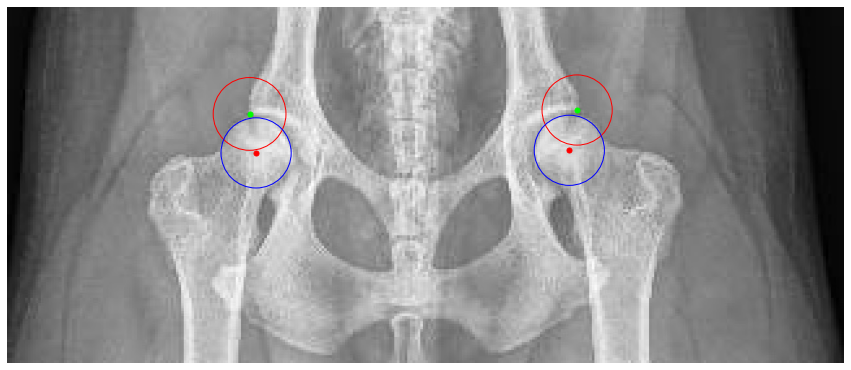

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg
head: [[[479  87]]

 [[206  98]]]
center: [[[466 119]]

 [[215 130]]]


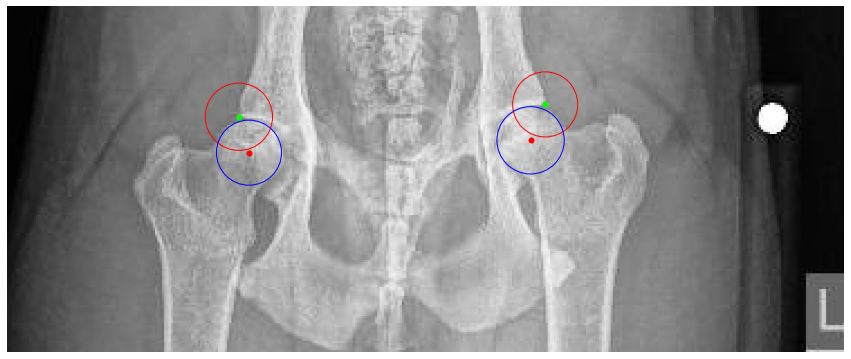

Processing /home/featurize/work/Dataset2/data/Testing/Images/352310.jpeg
head: [[[544  93]]

 [[199  95]]]
center: [[[541 131]]

 [[196 134]]]


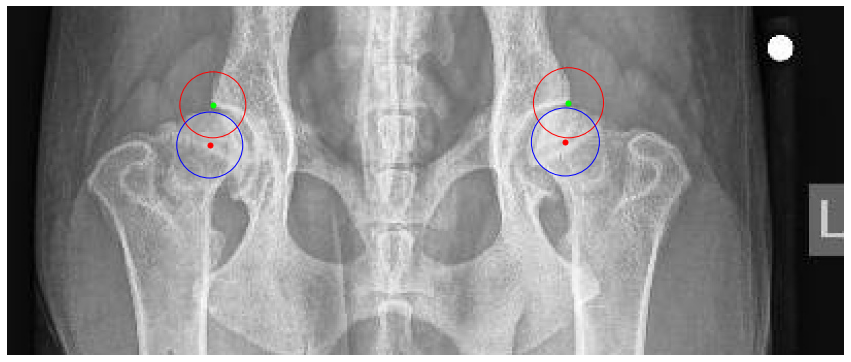

Processing /home/featurize/work/Dataset2/data/Testing/Images/364990.jpeg
head: [[[453  90]]

 [[165  76]]]
center: [[[440 124]]

 [[170 112]]]


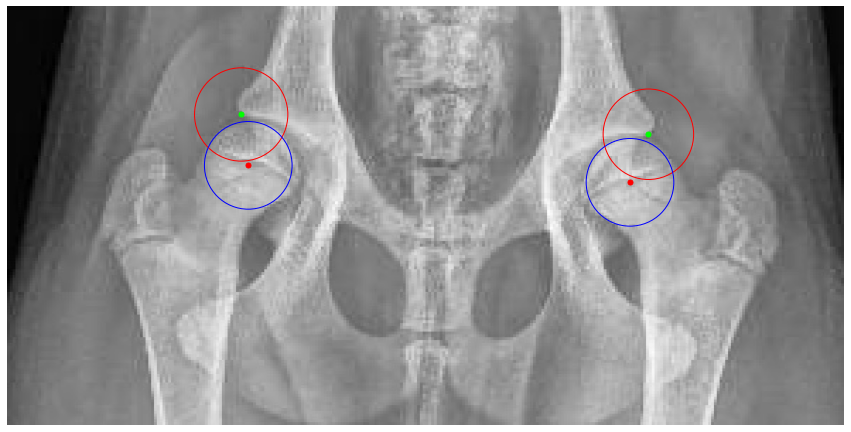

Processing /home/featurize/work/Dataset2/data/Testing/Images/361597.jpeg
head: [[[401  79]]

 [[145  80]]]
center: [[[387 105]]

 [[161 104]]]


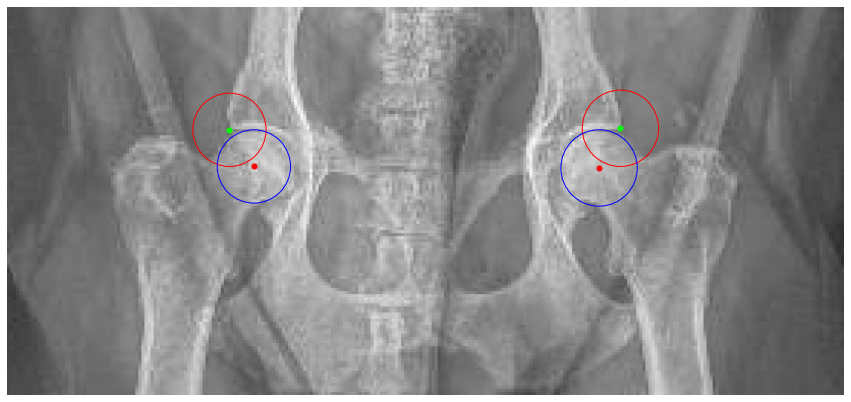

Processing /home/featurize/work/Dataset2/data/Testing/Images/360012.jpeg
head: [[[133  70]]

 [[417  72]]]
center: [[[408 102]]

 [[142 101]]]


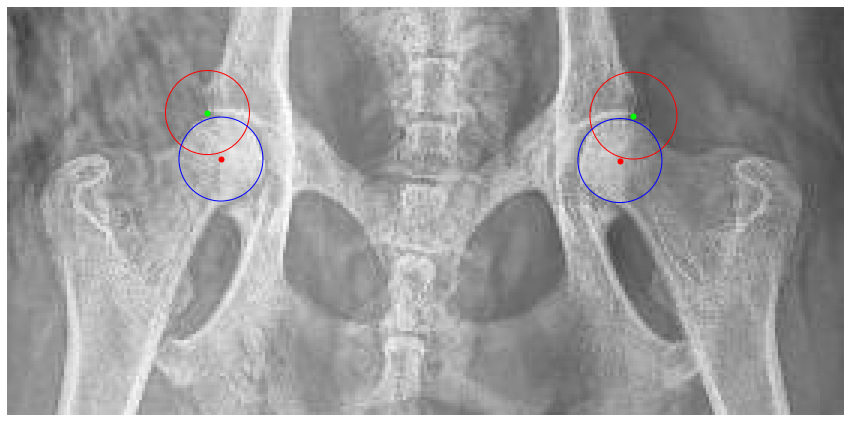

Processing /home/featurize/work/Dataset2/data/Testing/Images/329554.jpeg
head: [[[584 175]]

 [[266 138]]]
center: [[[565 206]]

 [[271 171]]]


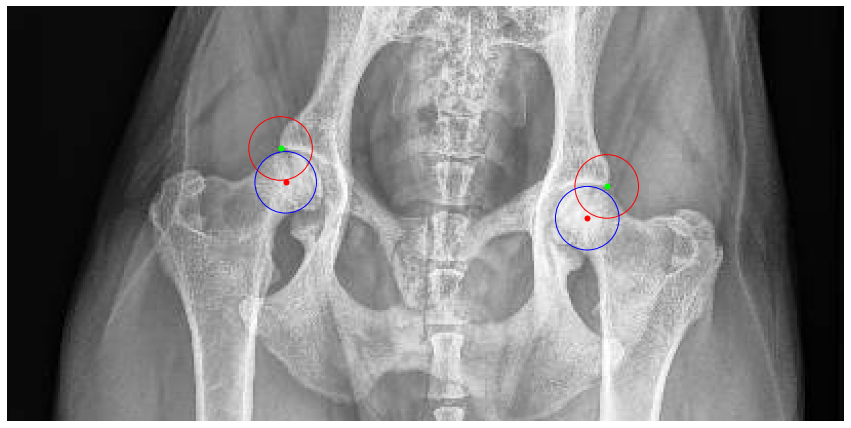

Processing /home/featurize/work/Dataset2/data/Testing/Images/357815.jpeg
head: [[[148  96]]

 [[417  91]]]
center: [[[409 121]]

 [[159 125]]]


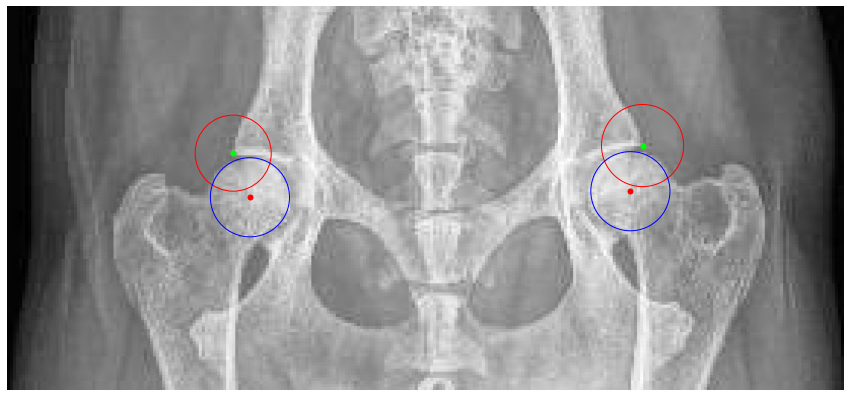

Processing /home/featurize/work/Dataset2/data/Testing/Images/354570.jpeg
head: [[[601 150]]

 [[283 139]]]
center: [[[589 187]]

 [[293 176]]]


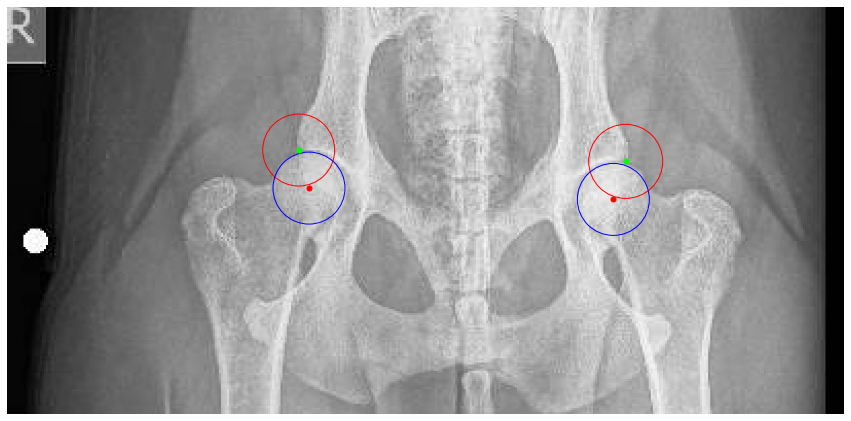

Processing /home/featurize/work/Dataset2/data/Testing/Images/361479.jpeg
head: [[[179  83]]

 [[496  90]]]
center: [[[189 118]]

 [[484 125]]]


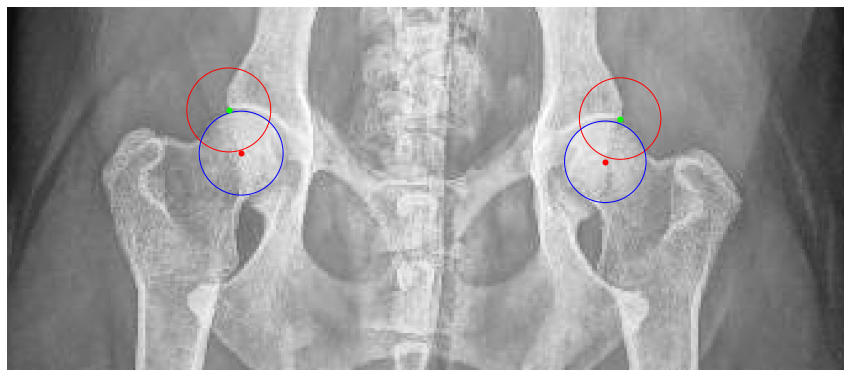

Processing /home/featurize/work/Dataset2/data/Testing/Images/357153.jpeg
head: [[[547 128]]

 [[228 129]]]
center: [[[536 166]]

 [[239 162]]]


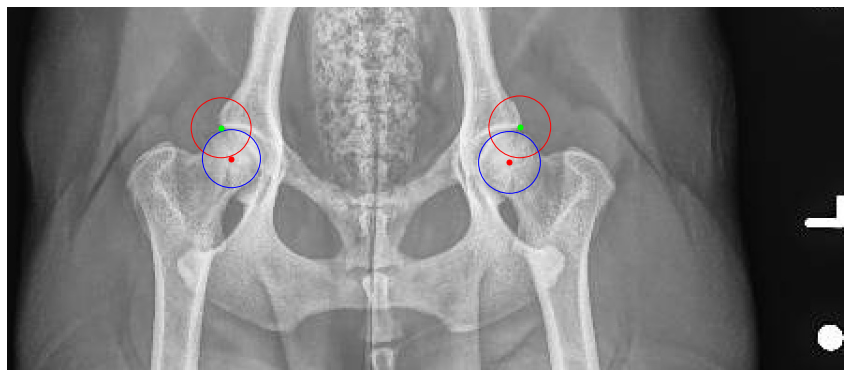

Processing /home/featurize/work/Dataset2/data/Testing/Images/308700.jpg
head: [[[1080  230]]

 [[ 336  171]]]
center: [[[ 345  248]]

 [[1049  309]]]


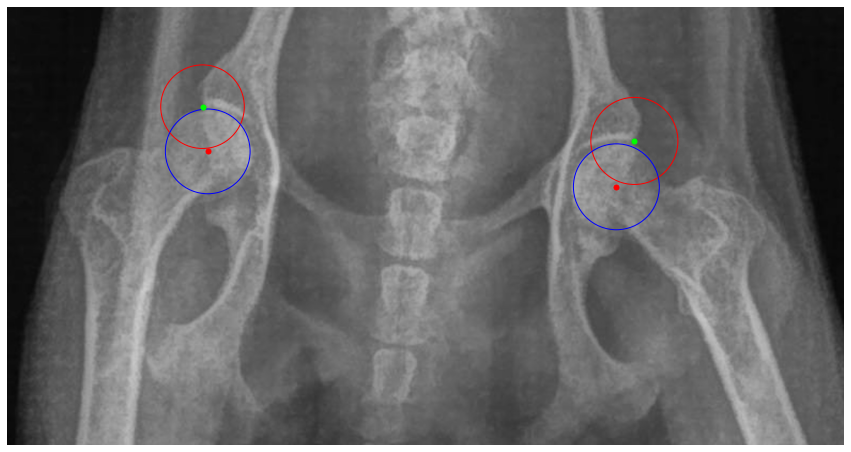

Processing /home/featurize/work/Dataset2/data/Testing/Images/361233.jpeg
head: [[[204  79]]

 [[507 102]]]
center: [[[212 114]]

 [[499 137]]]


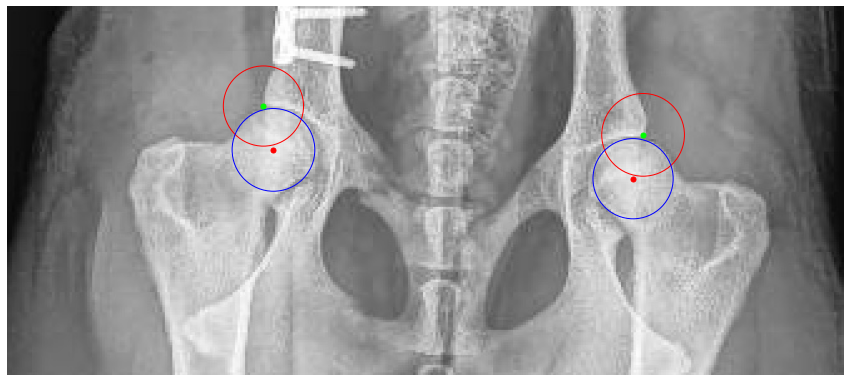

Processing /home/featurize/work/Dataset2/data/Testing/Images/357274.jpeg
head: [[[442  90]]

 [[179  78]]]
center: [[[431 122]]

 [[167 107]]]


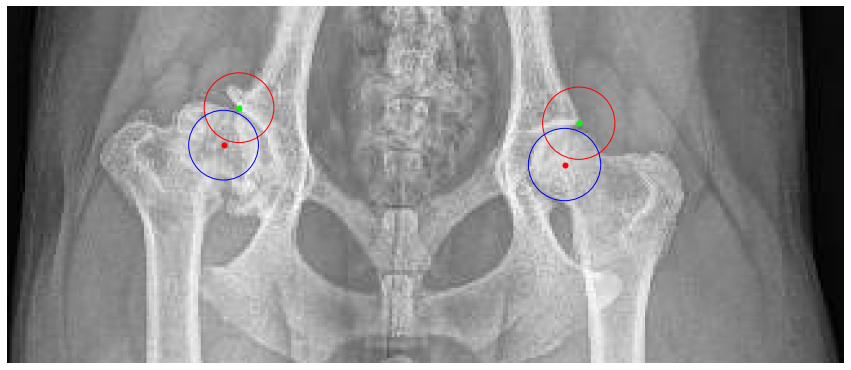

Processing /home/featurize/work/Dataset2/data/Testing/Images/330817.jpeg
head: [[[182  89]]

 [[472  98]]]
center: [[[481 133]]

 [[168 121]]]


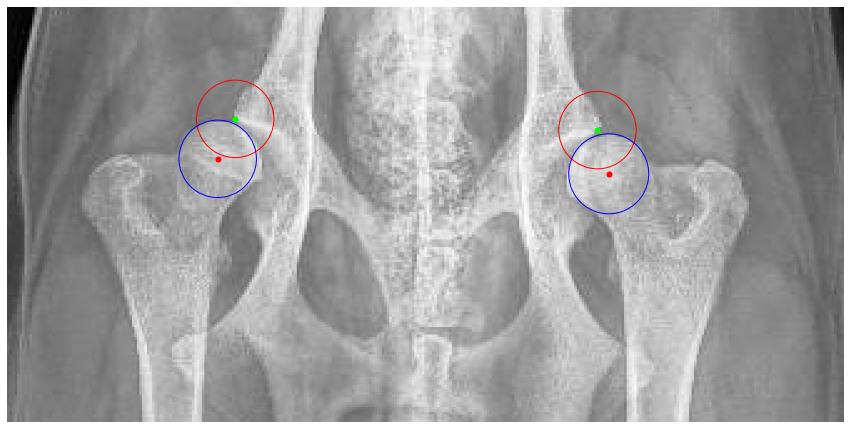

Processing /home/featurize/work/Dataset2/data/Testing/Images/359477.jpeg
head: [[[207  57]]

 [[499  74]]]
center: [[[487 108]]

 [[216  92]]]


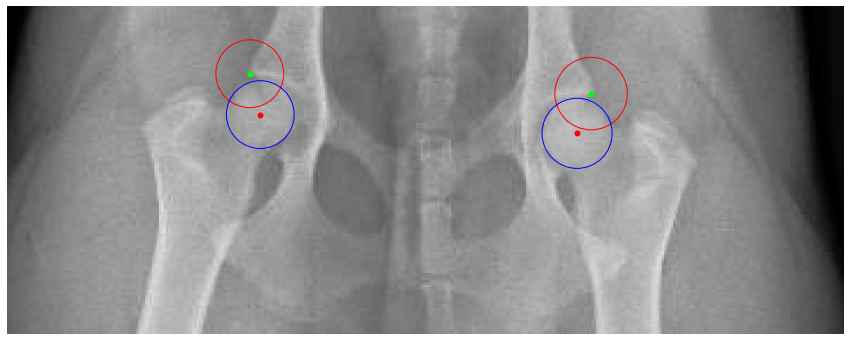

Processing /home/featurize/work/Dataset2/data/Testing/Images/320802.jpeg
head: [[[285 118]]

 [[600 118]]]
center: [[[595 152]]

 [[292 154]]]


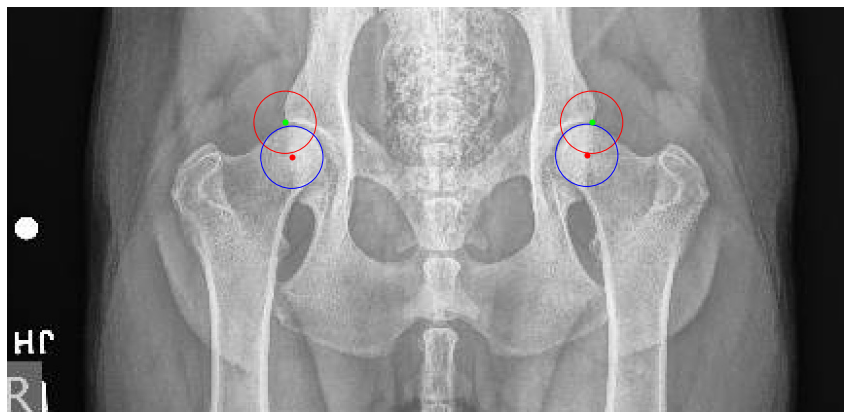

Processing /home/featurize/work/Dataset2/data/Testing/Images/362005.jpeg
head: [[[164  72]]

 [[427  65]]]
center: [[[426  94]]

 [[172 103]]]


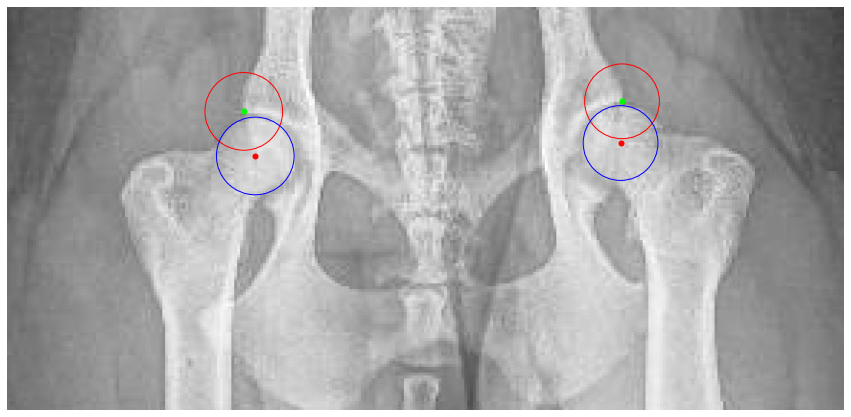

Processing /home/featurize/work/Dataset2/data/Testing/Images/362215.jpeg
head: [[[477  62]]

 [[185  77]]]
center: [[[468 101]]

 [[196 116]]]


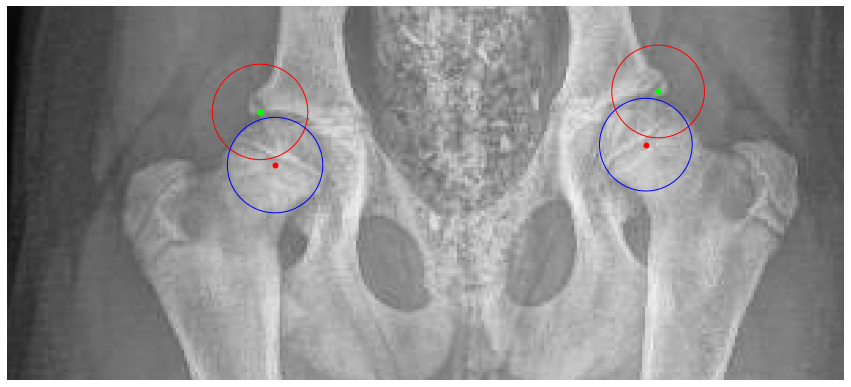

Processing /home/featurize/work/Dataset2/data/Testing/Images/351008.jpeg
head: [[[137  88]]

 [[390  70]]]
center: [[[144 124]]

 [[393 108]]]


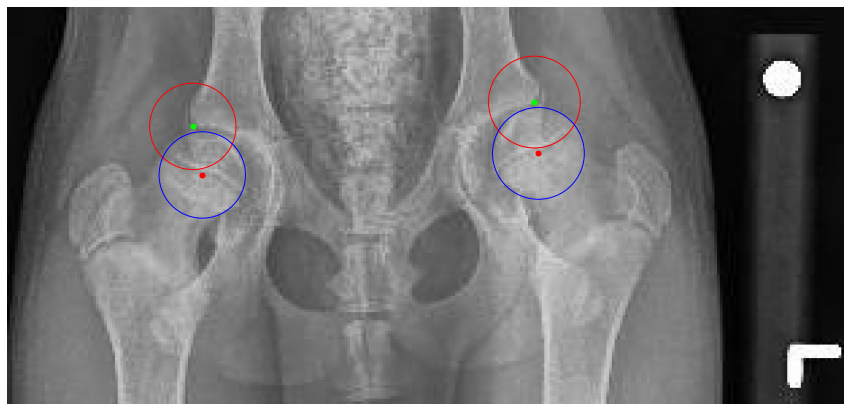

Processing /home/featurize/work/Dataset2/data/Testing/Images/356989.jpeg
head: [[[224  93]]

 [[505  86]]]
center: [[[214 119]]

 [[517 110]]]


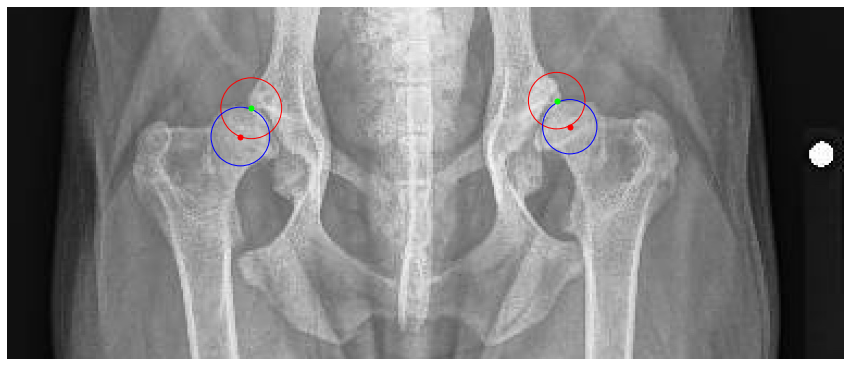

Processing /home/featurize/work/Dataset2/data/Testing/Images/331046.jpeg
head: [[[198 132]]

 [[546 125]]]
center: [[[529 161]]

 [[212 169]]]


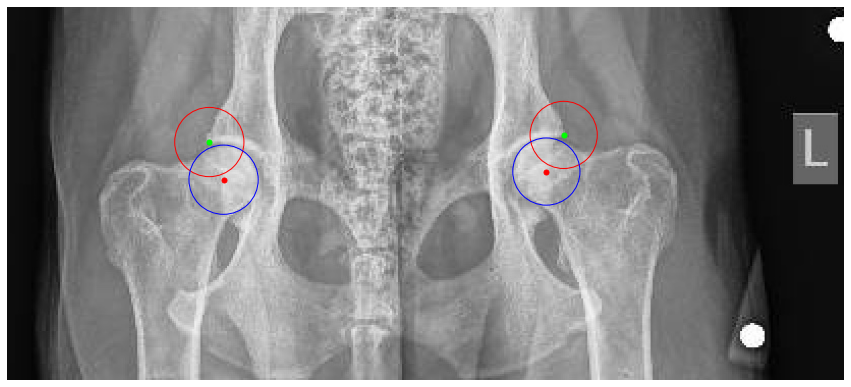

Processing /home/featurize/work/Dataset2/data/Testing/Images/324194.jpeg
head: [[[202 124]]

 [[499 113]]]
center: [[[488 147]]

 [[217 158]]]


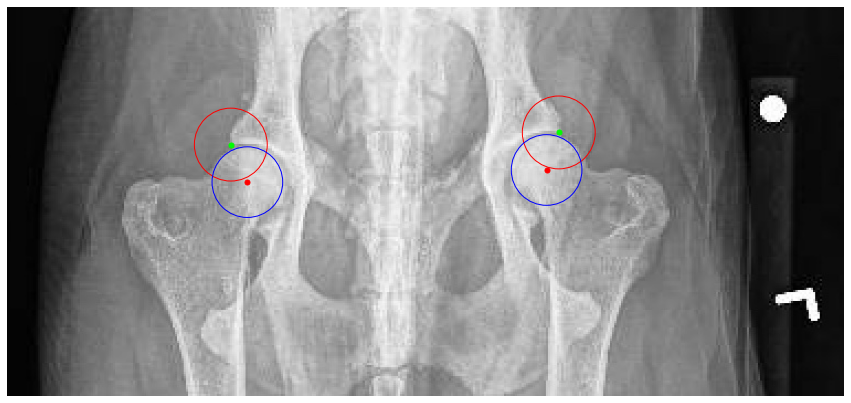

Processing /home/featurize/work/Dataset2/data/Testing/Images/342636.jpeg
head: [[[469 118]]

 [[229 117]]]
center: [[[483 141]]

 [[216 141]]]


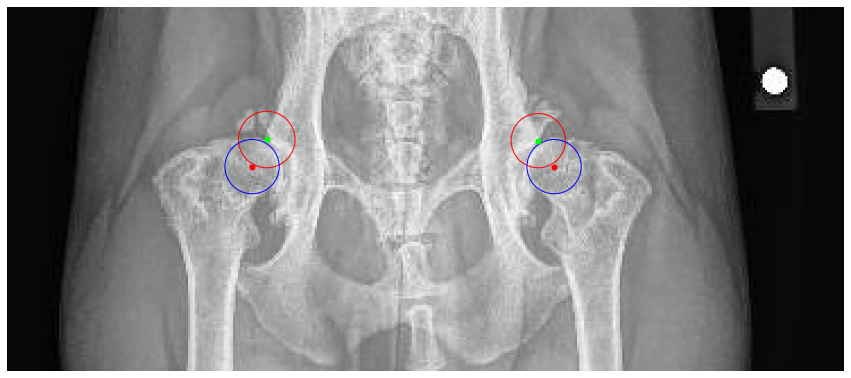

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg
head: [[[1247  193]]

 [[ 466  138]]]
center: [[[1306  271]]

 [[ 358  153]]]


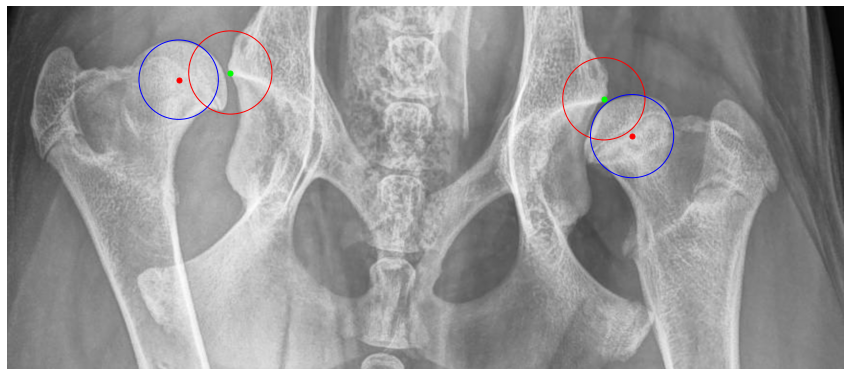

Processing /home/featurize/work/Dataset2/data/Testing/Images/363424.jpeg
head: [[[465  70]]

 [[177  77]]]
center: [[[459 103]]

 [[190 109]]]


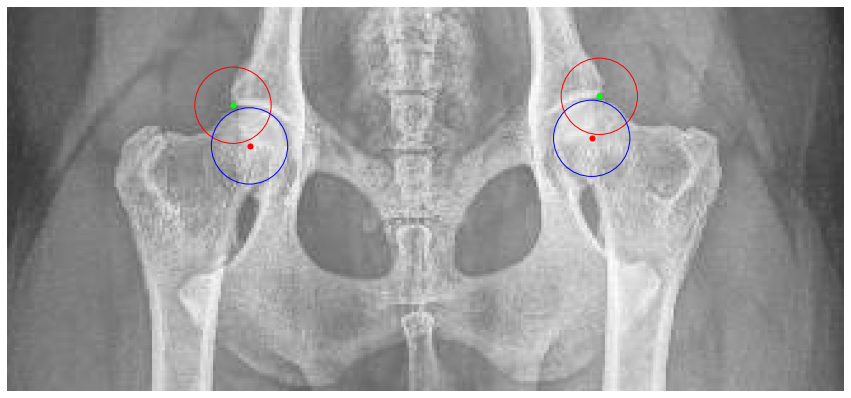

Processing /home/featurize/work/Dataset2/data/Testing/Images/351181.jpeg
head: [[[191  71]]

 [[451  56]]]
center: [[[188 102]]

 [[459  86]]]


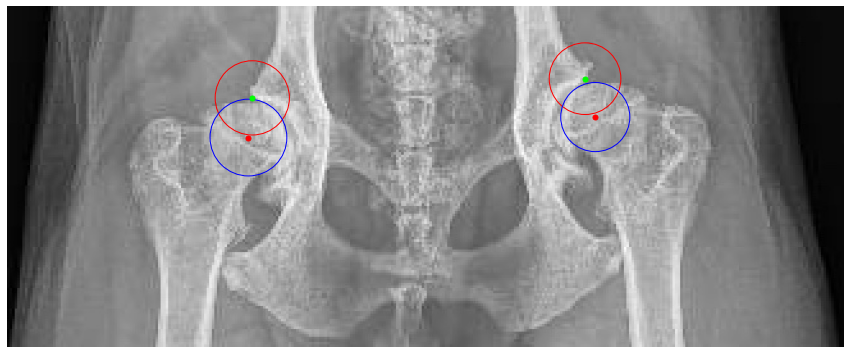

Processing /home/featurize/work/Dataset2/data/Testing/Images/282434.jpeg
head: [[[535  94]]

 [[248  87]]]
center: [[[526 128]]

 [[256 122]]]


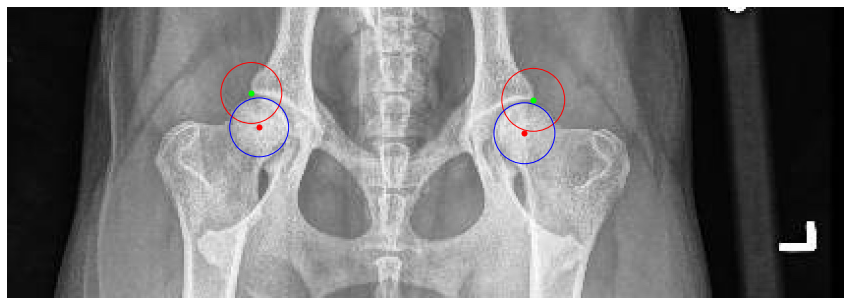

Processing /home/featurize/work/Dataset2/data/Testing/Images/281142.jpeg
head: [[[271  91]]

 [[586 102]]]
center: [[[257 125]]

 [[595 135]]]


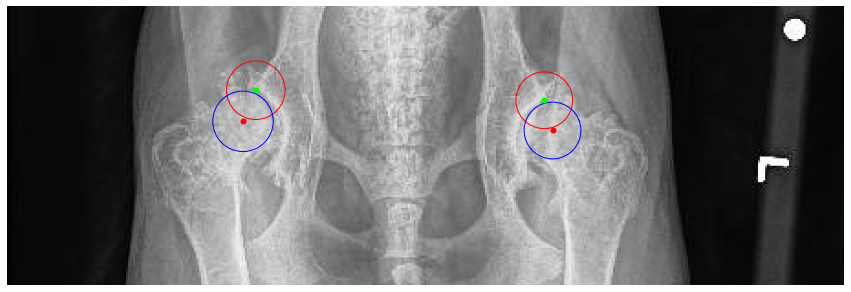

Processing /home/featurize/work/Dataset2/data/Testing/Images/359798.jpeg
head: [[[379  82]]

 [[137  60]]]
center: [[[369 108]]

 [[140  88]]]


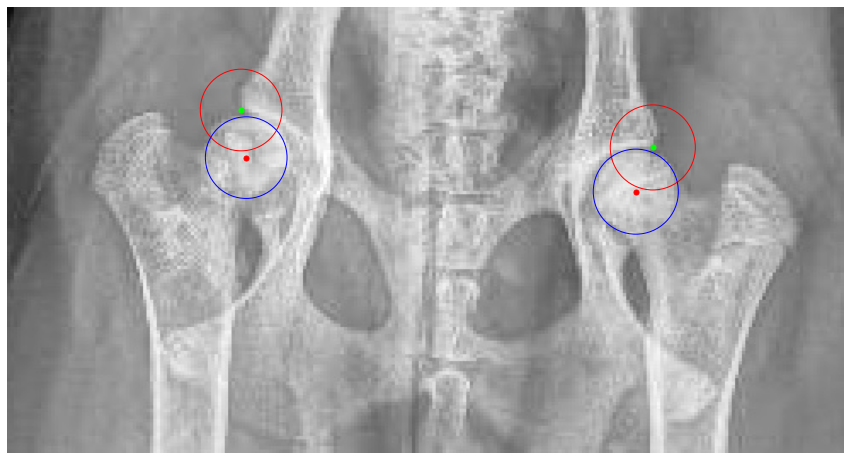

Processing /home/featurize/work/Dataset2/data/Testing/Images/293062.jpeg
head: [[[471 107]]

 [[188  89]]]
center: [[[198 121]]

 [[457 139]]]


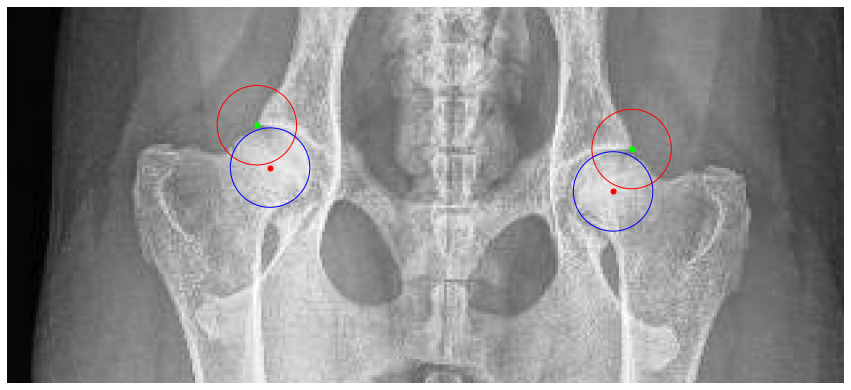

Processing /home/featurize/work/Dataset2/data/Testing/Images/308131.jpeg
head: [[[597  97]]

 [[277 105]]]
center: [[[587 132]]

 [[290 141]]]


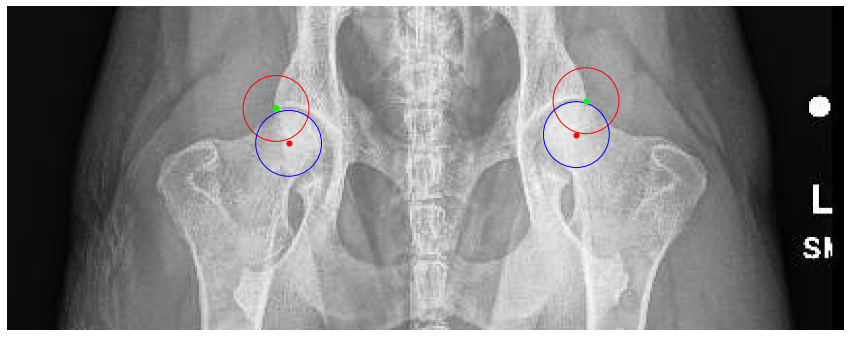

Processing /home/featurize/work/Dataset2/data/Testing/Images/332903.jpeg
head: [[[299 146]]

 [[558 140]]]
center: [[[552 169]]

 [[305 173]]]


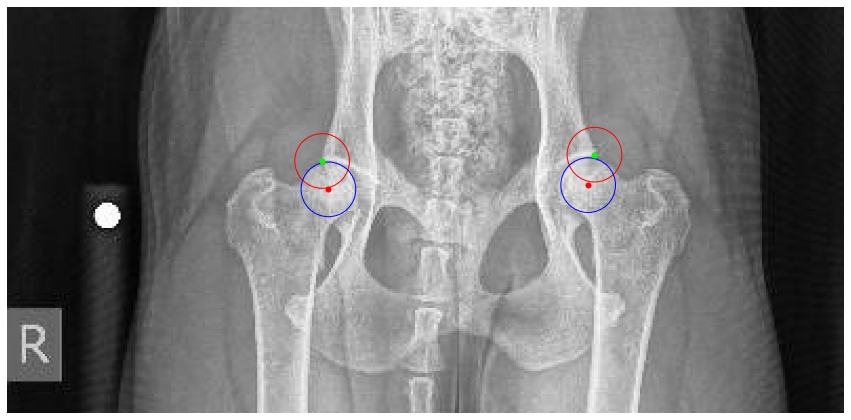

In [18]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    
    CONF_THRES = 0.38

    pred_instance_all = detect_result_all.pred_instances.cuda().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > CONF_THRES)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > CONF_THRES)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
                
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            #rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                all_x = x
                all_y = y
                radius = max(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((all_x, all_y), radius, color='r', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)

    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            #rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                all_x = x
                all_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((all_x, all_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)
    plt.axis('off')
    plt.show()

In [12]:
## Predict
def predict_and_plot(image_path, detector, pose_estimator, conf_thres_center=0.39, conf_thres_head=0.46):
    print(f'Processing {image_path}')
    image = imread(image_path)

    colors = [
        (255, 0, 0),    # 红色
        (0, 255, 0),    # 绿色
        (0, 0, 255),    # 蓝色
        (255, 255, 0),  # 黄色
    ]

    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    

    pred_instance_all = detect_result_all.pred_instances.cuda().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    # head
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            #print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            

    # center   
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            

    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = max(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)

    plt.axis('off')
    plt.show()

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg


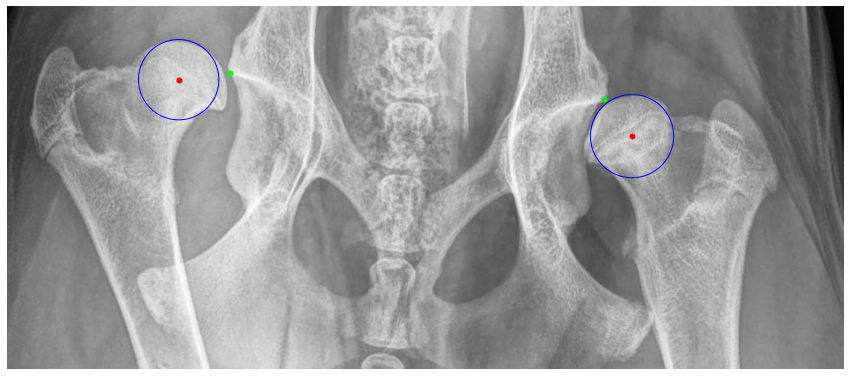

In [17]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/361122.jpg'
predict_and_plot(image_path, detector, pose_estimator,  conf_thres_center=0.42, conf_thres_head=0.43)

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg


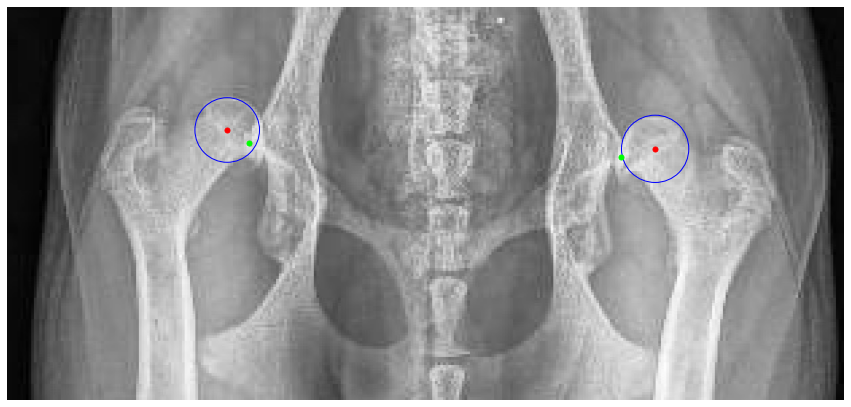

In [18]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg'
predict_and_plot(image_path, detector, pose_estimator,  conf_thres_center=0.42, conf_thres_head=0.38)

In [13]:
def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def predict_and_save(image_path, mat_file_path, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.4):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    ### 
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    

    pred_instance_all = detect_result_all.pred_instances.cuda().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)
    bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
    bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    # head
    heads_pred = []
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
            #print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            

    # center  
    centers_pred = []
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
    

    # Initialize DataFrame with ground truth values
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]],
        'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]],
        'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]],
        'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]],
        'Center2 Y': [center2[1]],
        'Radius1': [radius1],
        'Radius2': [radius2],
        'Angle1': [angles[0][0]],
        'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan],
        'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan],
        'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan],
        'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan],
        'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan],
        'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan],
        'Pred Angle2': [np.nan]
    })

    # Update DataFrame with predicted values if predictions are available
    if len(centers_pred) >= 2 and len(heads_pred) >= 2:
        # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
        centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

        predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
        predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
        predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
        predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

        pred_left_head = heads_pred[0][0]
        pred_right_head = heads_pred[1][0]
        pred_center1 = centers_pred[0][0]
        pred_center2 = centers_pred[1][0]

        df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
        df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
        df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
        df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
        df.loc[0, 'Pred Center1 X'] = pred_center1[0]
        df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
        df.loc[0, 'Pred Center2 X'] = pred_center2[0]
        df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
        df.loc[0, 'Pred Radius1'] = predicted_radius1
        df.loc[0, 'Pred Radius2'] = predicted_radius2
        df.loc[0, 'Pred Angle1'] = predicted_angle1
        df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

def process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.4, output_dir='/home/featurize/work/Result'):
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    all_dfs = []

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, pose_estimator, conf_thres_center, conf_thres_head)
            all_dfs.append(df)
        else:
            print(f'MAT file for image {image_file} not found.')

    # Combine all dataframes and save to CSV
    final_df = pd.concat(all_dfs, ignore_index=True)
    #final_df.to_csv(os.path.join(output_dir, 'predictions_all.csv'), index=False)
    return final_df
# Example usage
#image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
#label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46, output_dir='/home/featurize/work/Result')


In [20]:
# Example usage
image_dir = '/home/featurize/work/Dataset2/July_2024/Images'
label_dir = '/home/featurize/work/Dataset2/July_2024/Labels'
df =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')

In [18]:
#df.to_csv('/home/featurize/work/Dataset2/data/Testing/Images/111.csv',index=False)

In [23]:
# distances = np.sqrt(
#     (df['Center2 X'] - df['Pred Center2 X']) ** 2 + 
#     (df['Center2 Y'] - df['Pred Center2 Y']) ** 2
# )

# # 计算距离的 MAE
# mae_distance = mean_absolute_error(distances, np.zeros_like(distances))

# print(f"MAE of distances between Center2 and Pred Center2: {mae_distance}")
# radius1_diff = np.abs(df['Radius1'] - df['Pred Radius1']).mean()
# radius2_diff = np.abs(df['Radius2'] - df['Pred Radius2']).mean()

# print(f"Average difference for Radius1: {radius1_diff}")
# print(f"Average difference for Radius2: {radius2_diff}")

# radius1_less_than = np.sum(df['Pred Radius1'] < df['Radius1'])
# radius2_less_than = np.sum(df['Pred Radius2'] < df['Radius2'])

# # 计算总的样本数量
# total_samples = len(df)

# # 计算百分比
# radius1_percentage = (radius1_less_than / total_samples) * 100
# radius2_percentage = (radius2_less_than / total_samples) * 100

# print(f"Percentage of Pred Radius1 < Radius1: {radius1_percentage}%")
# print(f"Percentage of Pred Radius2 < Radius2: {radius2_percentage}%")

In [24]:
# left_head_mae = mean_absolute_error(df[['Left Head X', 'Left Head Y']], df[['Pred Left Head X', 'Pred Left Head Y']])
# print(f"MAE for Left Head: {left_head_mae}")

# # 计算 Center1 的 MAE
# center1_mae = mean_absolute_error(df[['Center1 X', 'Center1 Y']], df[['Pred Center1 X', 'Pred Center1 Y']])
# print(f"MAE for Center1: {center1_mae}")

# # 计算 Right Head 的 MAE
# right_head_mae = mean_absolute_error(df[['Right Head X', 'Right Head Y']], df[['Pred Right Head X', 'Pred Right Head Y']])
# print(f"MAE for Right Head: {right_head_mae}")

# # 计算 Center2 的 MAE
# center2_mae = mean_absolute_error(df[['Center2 X', 'Center2 Y']], df[['Pred Center2 X', 'Pred Center2 Y']])
# print(f"MAE for Center2: {center2_mae}")

In [14]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error
import seaborn as sns

def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'
    
def evaluate_df(df):
    # delta_angle
    df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
    df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

    percentage_less_than_1_degree = (
        ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于5度的百分比
    percentage_less_than_5_degrees = (
        ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于10度的百分比
    percentage_less_than_10_degrees = (
        ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
    ) * 100

    print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
    print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
    print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

    angle1_under_5 = (df['Delta Angle1'] < 5).sum()
    angle2_under_5 = (df['Delta Angle2'] < 5).sum()
    total_entries = len(df)

    percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
    percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
    print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

    angle1_under_10 = (df['Delta Angle1'] < 10).sum()
    angle2_under_10 = (df['Delta Angle2'] < 10).sum()

    percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
    percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
    print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")
    
    mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
    mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
    combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
    combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
    mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)


    print(f"MAE for Angle1: {mae_angle1}")
    print(f"MAE for Angle2: {mae_angle2}")
    print(f"MAE for all Angles: {mae_combined_angles}")


    # mse
    mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                   df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                                   df[['Pred Angle1', 'Pred Angle2']])

    mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                    df[['Pred Radius1', 'Pred Radius2']])

    # MAPE
    mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                                df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

    mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                                df[['Pred Angle1', 'Pred Angle2']])

    mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                                 df[['Pred Radius1', 'Pred Radius2']])

    # R2
    r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                            df[['Pred Left Head X', 'Pred Left Head Y']])

    r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                             df[['Pred Right Head X', 'Pred Right Head Y']])

    r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                          df[['Pred Center1 X', 'Pred Center1 Y']])

    r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                          df[['Pred Center2 X', 'Pred Center2 Y']])

    r2_angle = r2_score(df[['Angle1', 'Angle2']],
                        df[['Pred Angle1', 'Pred Angle2']])
    
    # 相关性分析
    print('------------------------------------------------')
    angle1_corr = df['Angle1'].corr(df['Pred Angle1'])
    angle2_corr = df['Angle2'].corr(df['Pred Angle2'])
    
    print(f"Correlation between Angle1 and Pred Angle1: {angle1_corr:.2f}")
    print(f"Correlation between Angle2 and Pred Angle2: {angle2_corr:.2f}")
    print('------------------------------------------------')

    print(f"MSE Point: {mse_point}")
    print(f"MSE Angle: {mse_angle}")
    print(f"MSE Radius: {mse_radius}")
    print(f"MAPE Point: {mape_point}")
    print(f"MAPE Angle: {mape_angle}")
    print(f"MAPE Radius: {mape_radius}")
    print(f"R2 Head Left: {r2_head_left}")
    print(f"R2 Head Right: {r2_head_right}")
    print(f"R2 Center1: {r2_center1}")
    print(f"R2 Center2: {r2_center2}")
    print(f"R2 Angle: {r2_angle}")
    
    
    df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
    df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

    df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
    df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)
    
    total_count = len(df)
    same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
    percentage_same_classification1 = (same_classification_count1 / total_count) * 100

    print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

    same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
    percentage_same_classification2 = (same_classification_count2 / total_count) * 100

    print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")
    
    ##
    df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
    df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

    # Delta Angle1
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
    plt.xlabel('Delta Angle1 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
    plt.show()

    # Delta Angle2
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
    plt.xlabel('Delta Angle2 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
    
    
    filtered_df = df[(df['Delta Angle1'] > 10)]
    for index, row in filtered_df.iterrows():
        image_path = row['Image Path']
        image_name = os.path.basename(image_path)
        image = cv2.imread(image_path)
        print(f'File: {image_name}')

        true_points = np.array([
            [row['Left Head X'], row['Left Head Y']],
            [row['Right Head X'], row['Right Head Y']],
            [row['Center1 X'], row['Center1 Y']],
            [row['Center2 X'], row['Center2 Y']]
        ], dtype=int)


        pred_points = np.array([
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']]
        ], dtype=int)

        fig, ax = plt.subplots(1, 2, figsize=(15, 7))


        ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in true_points:
            ax[0].plot(point[0], point[1], 'go')  

        ax[0].set_title(f'Original Image with True Points\nDelta Angle: {row["Delta Angle1"]:.2f}\nFile: {image_name}')


        ax[1].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in pred_points:
            ax[1].plot(point[0], point[1], 'ro') 

        ax[1].set_title('Image with Predicted Points')

        plt.show()

Percentage of angles with less than 1 degree error: 24.05%
Percentage of angles with less than 5 degrees error: 82.06%
Percentage of angles with less than 10 degrees error: 97.71%
Percentage of Delta Angle1 < 5: 80.92%
Percentage of Delta Angle2 < 5: 83.21%
Percentage of Delta Angle1 < 10: 96.95%
Percentage of Delta Angle2 < 10: 98.47%
MAE for Angle1: 3.2422069478046343
MAE for Angle2: 3.065084531583992
MAE for all Angles: 3.1536457396943134
------------------------------------------------
Correlation between Angle1 and Pred Angle1: 0.96
Correlation between Angle2 and Pred Angle2: 0.95
------------------------------------------------
MSE Point: 9.098063753327509
MSE Angle: 18.736931808745606
MSE Radius: 6.525513210536591
MAPE Point: 0.01494789884071631
MAPE Angle: 0.03490620471197053
MAPE Radius: 0.036681138602869465
R2 Head Left: 0.9907720116356081
R2 Head Right: 0.996714626315845
R2 Center1: 0.9914434646915796
R2 Center2: 0.9963940853716199
R2 Angle: 0.883786164605235
Percentage of s

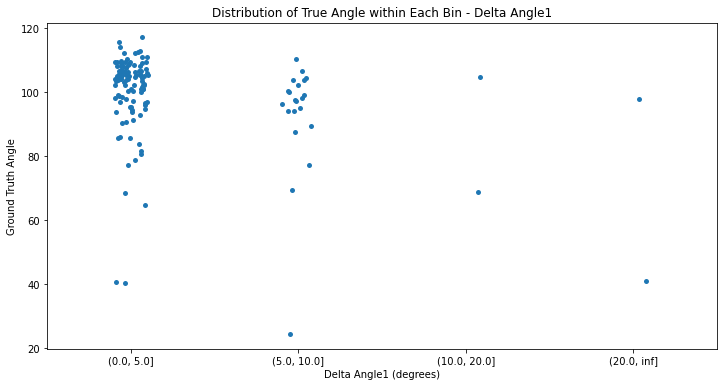

File: 138477.jpg


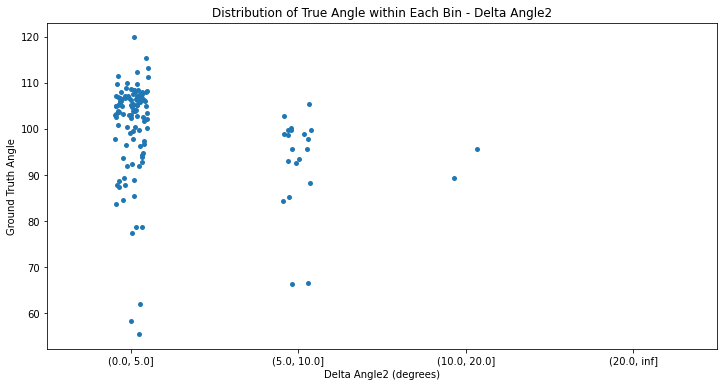

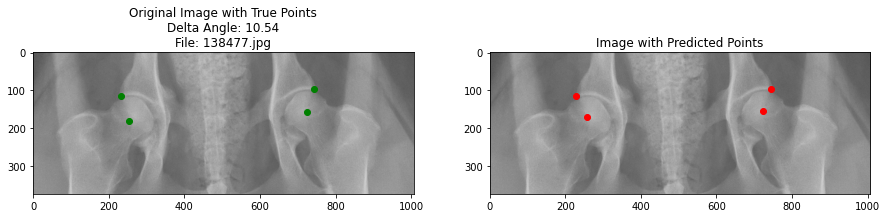

File: 39402.jpg


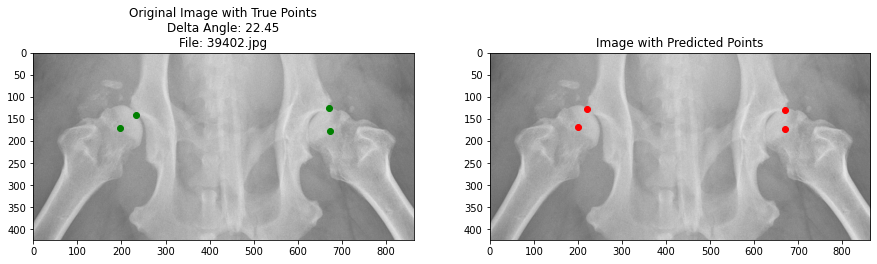

File: ZW1.jpg


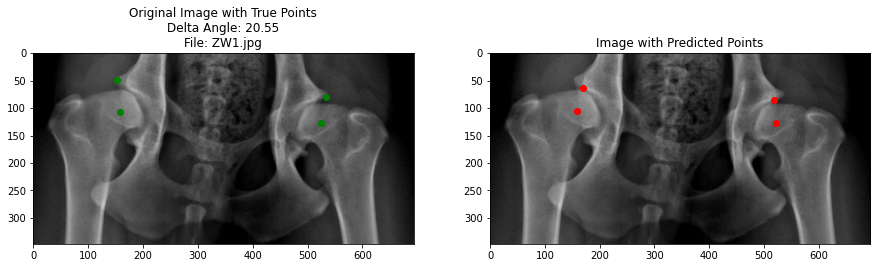

File: 6057.jpg


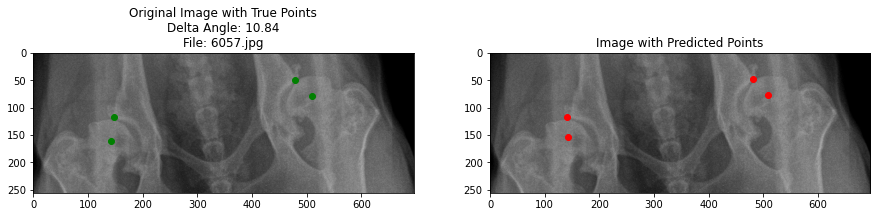

In [26]:
evaluate_df(df)

In [ ]:
image_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_1/Images'
label_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_1/Labels'
df_Tanay =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')
evaluate_df(df_Tanay)

In [ ]:
output_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_1/Predict_1'
save_predictions_to_mat(df_Tanay, output_dir)

In [ ]:
image_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_2/Images'
label_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_2/Labels'
df_Tanay2 =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')
evaluate_df(df_Tanay2)

In [ ]:
output_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_2/Predict_2'
save_predictions_to_mat(df_Tanay2, output_dir)

In [ ]:
image_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_3/Images'
label_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_3/Labels'
df_Tanay =process_all_images_and_save(image_dir, label_dir, detector, pose_estimator, conf_thres_center=0.38, conf_thres_head=0.38, output_dir='/home/featurize/work/Result')


In [ ]:
evaluate_df(df_Tanay)

In [ ]:
output_dir = '/home/featurize/work/Dataset2/Tanay/Dog_hip_images/caption_3/Predict_3'
save_predictions_to_mat(df_Tanay, output_dir)

In [15]:
## use different confidience threshold to compute best point

def calculate_error(pred_points, true_points):
    return np.mean(np.linalg.norm(pred_points - true_points, axis=1))

def predict_and_save_optimize(image_path, mat_file_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    Angles = mat_data['Angles']
    
    best_df = None
    best_error = float('inf')
    
    ###
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    pred_instance_all = detect_result_all.pred_instances.cuda().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)           
    
    ###
    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with ground truth values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Left Head X': [left_head[0]],
                'Left Head Y': [left_head[1]],
                'Right Head X': [right_head[0]],
                'Right Head Y': [right_head[1]],
                'Center1 X': [center1[0]],
                'Center1 Y': [center1[1]],
                'Center2 X': [center2[0]],
                'Center2 Y': [center2[1]],
                'Radius1': [radius1],
                'Radius2': [radius2],
                'Angle1': [Angles[0][0]],
                'Angle2': [Angles[0][1]],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) == 2 and len(heads_pred) == 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])


                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                # Calculate prediction error
                pred_points = np.array([pred_left_head, pred_right_head, pred_center1, pred_center2])
                true_points = np.array([left_head, right_head, center1, center2])
                error = calculate_error(pred_points, true_points)

                if error < best_error:
                    best_error = error
                    best_df = df

    return best_df

def process_all_images_and_save_optmize(image_dir, label_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save_optimize(image_path, mat_file_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        #output_path = os.path.join(output_dir, 'predictions.csv')
        #final_df.to_csv(output_path, index=False)
    return final_df
# Example usage
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [27]:
import time

start_time = time.time()

df2 = process_all_images_and_save_optmize(image_dir, label_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

end_time = time.time()

execution_time = end_time - start_time
print(f"Execution time: {execution_time} seconds")

Execution time: 234.2797031402588 seconds


Percentage of angles with less than 1 degree error: 19.01%
Percentage of angles with less than 5 degrees error: 80.17%
Percentage of angles with less than 10 degrees error: 99.17%
Percentage of Delta Angle1 < 5: 76.03%
Percentage of Delta Angle2 < 5: 84.30%
Percentage of Delta Angle1 < 10: 98.35%
Percentage of Delta Angle2 < 10: 100.00%
MAE for Angle1: 3.304869576057885
MAE for Angle2: 2.9946547770836034
MAE for all Angles: 3.1497621765707438
MSE Point: 8.609283976066004
MSE Angle: 15.261298787977143
MSE Radius: 5.341589182615026
MAPE Point: 0.012331739387895403
MAPE Angle: 0.03615560870437576
MAPE Radius: 0.03163553155695664
R2 Head Left: 0.9941937407724004
R2 Head Right: 0.9978207964641645
R2 Center1: 0.998418590811106
R2 Center2: 0.9988013092986571
R2 Angle: 0.9468583358484295
Percentage of same classification angle1: 66.94%
Percentage of same classification angle2: 61.98%


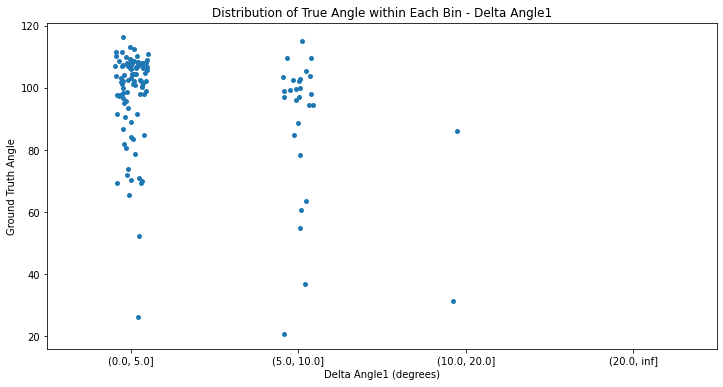

File: 341649.jpeg


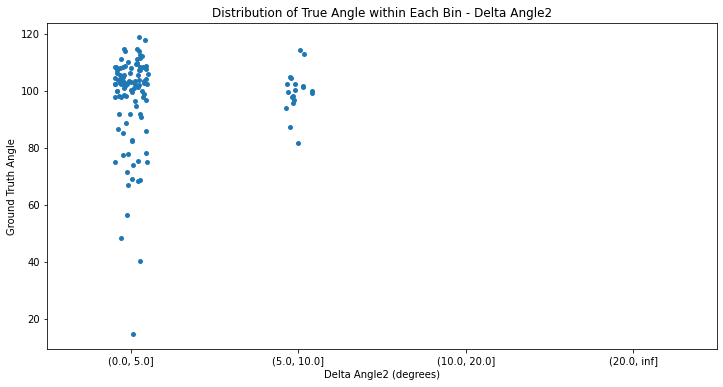

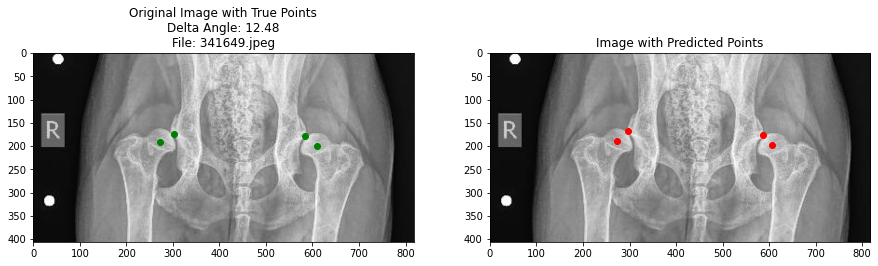

File: 360391.jpeg


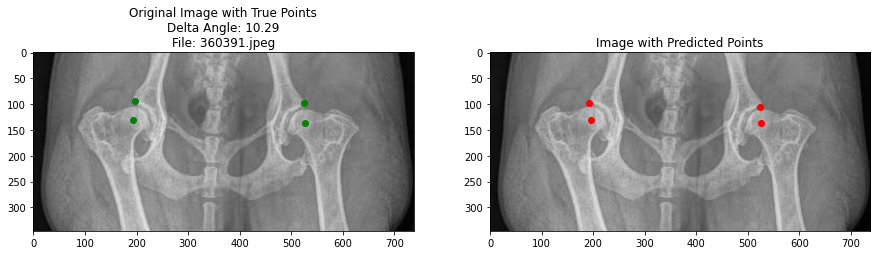

In [28]:
evaluate_df(df2)

In [16]:
def save_predictions_to_mat(df, output_dir):
    for index, row in df.iterrows():
        
        image_file_name = os.path.splitext(os.path.basename(row['Image Path']))[0]
        
        
        four_points = np.array([
           
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']],
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Radius1'], row['Pred Radius2']]
        ])
        
        
        angles = np.array([[row['Pred Angle1'], row['Pred Angle2']]])
        
        
        mat_content = {
            '__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: ' + bytes(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'), 'utf-8'),
            '__version__': '1.0',
            '__globals__': [],
            'Four_points': four_points,
            'Angles': angles
        }
        
        
        file_name = f"{image_file_name}.mat"
        file_path = os.path.join(output_dir, file_name)
        
        
        scipy.io.savemat(file_path, mat_content)
        print(f"Saved predictions to {file_path}")


#output_dir = '/home/featurize/work/Result/Predict'
#save_predictions_to_mat(df, output_dir)

In [17]:
def predict_optimize_image_only(image_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    
    best_df = None
    ###
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    detect_result_all = inference_detector(detector, image_path)
    pred_instance_all = detect_result_all.pred_instances.cpu().numpy()
    bboxes_all = np.concatenate((pred_instance_all.bboxes, pred_instance_all.scores[:, None]), axis=1)           
    
    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_all[np.logical_and(pred_instance_all.labels == 1, pred_instance_all.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_all[np.logical_and(pred_instance_all.labels == 0, pred_instance_all.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')
###
    
            # Initialize DataFrame with predicted values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) == 2 and len(heads_pred) == 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = max(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = max(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0], heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                best_df = df
                break  

    return best_df

def process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        if image_path.lower().endswith(('.jpg', '.jpeg', '.png')):
            df = predict_optimize_image_only(image_path, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        #output_path = os.path.join(output_dir, 'predictions_without_gt.csv')
        #final_df.to_csv(output_path, index=False)
    return final_df

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

df3=process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

In [28]:
image_dir = '/home/featurize/work/Dataset2/hip_generated'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

df4=process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

In [31]:
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df4, output_dir)

Saved predictions to /home/featurize/work/Result/Predict/dog_hip_51_5.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_117_19.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_268_6.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_68_3.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_63_7.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_101_17.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_135_13.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_35_1.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_132_18.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_40_14.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_111_4.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_388_14.mat
Saved predictions to /home/featurize/work/Result/Predict/dog_hip_128_2.mat
Saved predictions to /ho

In [20]:
image_dir = '/home/featurize/work/Dataset2/Tanay_new/Images'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Dataset2/Tanay_new/Predict'

df5=process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

08/06 08:47:32 - mmengine - WARNING - The current default scope "mmpose" is not "mmdet", `init_default_scope` will force set the currentdefault scope to "mmdet".
08/06 08:47:33 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".


In [21]:
output_dir = '/home/featurize/work/Dataset2/Tanay_new/Predict'
save_predictions_to_mat(df5, output_dir)

Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1764.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1305.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1473.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/2107.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1012.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1959.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/25.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/866.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/414.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/362.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/703.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/1988.mat
Saved predictions to /home/featurize/work/Dataset2/Tanay_new/Predict/9

In [19]:
image_dir = '/home/featurize/data/Images'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/data/Predict'

df6=process_images_only_and_save(image_dir, detector, pose_estimator, conf_thres_center_range, conf_thres_head_range, output_dir)

In [20]:
output_dir = '/home/featurize/data/Predict'
save_predictions_to_mat(df6, output_dir)

Saved predictions to /home/featurize/data/Predict/8845.mat
Saved predictions to /home/featurize/data/Predict/4455.mat
Saved predictions to /home/featurize/data/Predict/5809.mat
Saved predictions to /home/featurize/data/Predict/9035.mat
Saved predictions to /home/featurize/data/Predict/9605.mat
Saved predictions to /home/featurize/data/Predict/4218.mat
Saved predictions to /home/featurize/data/Predict/9492.mat
Saved predictions to /home/featurize/data/Predict/2307.mat
Saved predictions to /home/featurize/data/Predict/4866.mat
Saved predictions to /home/featurize/data/Predict/3719.mat
Saved predictions to /home/featurize/data/Predict/5797.mat
Saved predictions to /home/featurize/data/Predict/2949.mat
Saved predictions to /home/featurize/data/Predict/2341.mat
Saved predictions to /home/featurize/data/Predict/4468.mat
Saved predictions to /home/featurize/data/Predict/8134.mat
Saved predictions to /home/featurize/data/Predict/2263.mat
Saved predictions to /home/featurize/data/Predict/5135.m